# Face Mask Detection
The following notebook is an exercise for the Convolutional Neural Networks for Computer Vision course at Afeka College of Engineering.  
It uses Kaggle's Face Mask Detection [dataset](https://www.kaggle.com/andrewmvd/face-mask-detection) for Multi-Label Object Detection.  

**Table of Contents**:
 * [Imports](#imports)
 * [Configurations](#configurations)
 * [Data Load](#data-load)
 * [Data Exploration](#data-exploration)
   * [Image and Label Counts](#images-and-labels-count)
   * [Classes Distribution](#classes-distribution)
   * [Classes Combinations Distribution](#classes-combinations-distribution)
   * [Number of Faces per Image](#number-of-faces-per-image)
 * [Spliting the Data](#spliting-the-data)
 * [Data Samples](#data-samples)
   * [Real Data Samples](#real-data-samples)
   * [Augmentation Samples](#augmentation-samples)
 * [Training](#training)
 * [Evaluation](#evaluation)
   * [Examples](#examples)
   * [Mean Average Precision](#mean-average-precision)
 * [References](#references)

Submitted By:
 * Tal Goldengoren
 * Guy Kabiri 



##  Imports

In [1]:
import os
import sys
from datetime import datetime

import numpy as np
import pandas as pd
import cv2
import torch
from torch.utils.data import DataLoader
import torch.optim as optim
import torchvision
from sklearn import metrics

from iterstrat.ml_stratifiers import MultilabelStratifiedKFold

from matplotlib import pyplot as plt
import seaborn as sns

In [2]:
from data_handler.FaceMaskData import FaceMaskData
from data_handler.FaceMaskDataset import FaceMaskDataset
from trainer import *
from metrics.metrics import *
from criterion.criterion import *

In [3]:
assert torch.cuda.is_available()

## Configurations

In [4]:
DEBUG = False

class CFG:
    seed = 42
    model_name = 'faster_rcnn'
    pretrained = True
    img_width = 480
    img_height = 480
    batch_size = 10
    n_epochs = 20
    n_folds = 5
    drop_rate = 0.
    train_size = 0.90
    nms_thresh = 0.2
    score_threshold = 0.5
    device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
    num_workers = 4
    num_classes = 4
    imgs_path = 'images'        #   images dir
    msks_path = 'annotations'   #   annotations dir
    multilabelKFold = True

    optimizer = optim.SGD
    optimizer_dict = {  'lr':           0.005,
                        'momentum':     0.9,
                        'weight_decay': 0.0005 }
    
    scheduler = optim.lr_scheduler.StepLR
    scheduler_dict = { 'step_size': 5,
                        'gamma':    0.1 }

    def save(path):
        save_path = path + '/model_dict.json'
        with open(save_path, 'w') as f:
            for key, val in CFG.__dict__.items():
                f.write('{}\t\t= {}\n'.format(key, val))

# optimizer = optim.Adam
# optimizer_dict = None
# scheduler = optim.lr_scheduler.StepLR
# scheduler_dict = {    'step_size':   5,
#                       'gamma':        0.1 }

# optimizer = optim.ASGD
# optimizer_dict = None
# scheduler = optim.lr_scheduler.ExponentialLR
# scheduler_dict = { gamma: 0.9 }

np.random.seed(CFG.seed)

## Data Load

Load the data into a dataset

In [5]:
df = pd.read_csv(os.path.join(sys.path[0], 'annotation.csv'))

if CFG.multilabelKFold and CFG.n_folds > 1:
    faceMasksData = FaceMaskData(CFG.imgs_path, CFG.msks_path, multilabelKFold=True, df_file=df)
    (x_train, y_train, l_train), (x_test, y_test, l_test) = faceMasksData.load_data(
                                                                                    train_size=CFG.train_size,
                                                                                    drop_rate=CFG.drop_rate,
                                                                                    seed=CFG.seed)

else:
    faceMasksData = FaceMaskData(CFG.imgs_path, CFG.msks_path)
    (x_train, y_train), (x_test, y_test) = faceMasksData.load_data(
                                                                    train_size=CFG.train_size,
                                                                    drop_rate=CFG.drop_rate,
                                                                    seed=CFG.seed)

print('Training contains {} samples which is {:g}% of the data'.format(len(x_train), len(x_train) * 100 / (len(x_train) + len(x_test))))
print('Testing contains {} samples which is {:g}% of the data'.format(len(x_test), len(x_test) * 100 / (len(x_train) + len(x_test))))

Training contains 767 samples which is 89.9179% of the data
Testing contains 86 samples which is 10.0821% of the data


In [6]:
testset = FaceMaskDataset(x_test, y_test, CFG.imgs_path, CFG.msks_path, CFG.img_width, CFG.img_height, transforms=get_transformer('test'))
test_loader = DataLoader(dataset=testset, batch_size=CFG.batch_size, shuffle=False, num_workers=CFG.num_workers, collate_fn=collate_fn)

## Data Exploration

In [7]:
df.head()

,xmin,ymin,xmax,ymax,name,file,width,height,class,Xcent,Ycent,boxW,boxH
0,28,55,46,71,with_mask,maksssksksss737,400,226,0,0.09250,0.278761,0.0450,0.070796
1,98,62,111,78,with_mask,maksssksksss737,400,226,0,0.26125,0.309735,0.0325,0.070796
2,159,50,193,90,mask_weared_incorrect,maksssksksss737,400,226,1,0.44000,0.309735,0.0850,0.176991
3,293,59,313,80,with_mask,maksssksksss737,400,226,0,0.75750,0.307522,0.0500,0.092920
4,352,51,372,72,with_mask,maksssksksss737,400,226,0,0.90500,0.272124,0.0500,0.092920


### Images and Labels Count

In [8]:
faces = len(df['file'].unique())
annotates = len(df)
print('There are total {} images in the data'.format(faces))
print('There are total {} annotated faces in the data'.format(annotates))
print('Average of {:.5f} per image'.format(annotates/faces))

There are total 853 images in the data
There are total 4072 annotated faces in the data
Average of 4.77374 per image


### Classes Distribution

,label,count
0,with_mask,3232
1,without_mask,717
2,mask_weared_incorrect,123


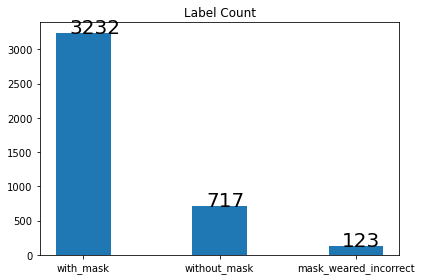

In [9]:
label_df = pd.DataFrame(columns=['label', 'count'])
for k, v in df['name'].value_counts().to_dict().items():
    label_df = label_df.append({'label':k, 'count':v}, ignore_index=True)
    
display(label_df)

fig, ax = plt.subplots()
ax.bar(label_df['label'], label_df['count'], width=0.4)
plt.title('Label Count')
for index, data in enumerate(label_df['count']):
    plt.text(x=index-0.1, y=data+1, s=data , fontdict=dict(fontsize=20))
plt.tight_layout()
plt.show()

### Classes Combinations Distribution

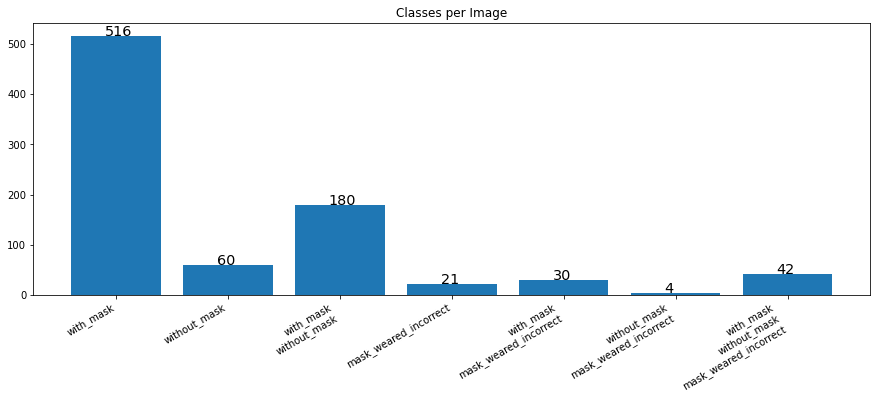

In [10]:
def get_class_distribute(df):
    classes = ["with_mask","without_mask","mask_weared_incorrect"]
    classes_bit_shifter_amount = {
        "with_mask":0,
        "without_mask":1,
        "mask_weared_incorrect":2,
    }
    
    dists = np.zeros(8)
    for name in faceMasksData.images:
        img_name = name.split('.')[0]
        img_classes = df[df['file']==img_name]['name'].unique()
        index = 0
        for cls in img_classes:
            index |= 1 << classes_bit_shifter_amount[cls]
            
        dists[index] += 1
    if dists[0] == 0:
        return dists[1:]
    return dists
            

dist_names = ['None', 'with_mask', 'without_mask', 'with_mask\nwithout_mask',
              'mask_weared_incorrect', 'with_mask\nmask_weared_incorrect',
              'without_mask\nmask_weared_incorrect',
              'with_mask\nwithout_mask\nmask_weared_incorrect']

dist_values = get_class_distribute(df)
if len(dist_values) == 7:
    dist_names = dist_names[1:]

plt.figure(figsize=(15, 5))
axs = plt.bar(dist_names, dist_values)
for ax in axs:
    plt.text(ax.get_xy()[0] + 0.3, ax.get_height(), int(ax.get_height()), fontsize='x-large')
plt.xticks(rotation=30, ha='right')
plt.title('Classes per Image')
plt.show()

Clearly, the data in these charts show a very imbalanced trend.  
Only 123 faces have an incorrectly worn mask, appearing in (21 + 30 + 4 + 42) = 97 images, which is (97 / 853) = 11% of all the images.  
However, the masks appeared on 768 / 853 = 90% of all images.  
In later stages of training, it will be necessary to divide the train and validation sets evenly to preserve the different labels at the same percentage.

### Number of Faces per Image

In [11]:
def get_num_faces(df, image_name_col):
    max_faces = find_max_faces(df,image_name_col)
    arr = [0] * (max_faces + 1)
    faces_count =1
    current_img =df.at[0,image_name_col]
    for i in range(1,len(df[1:])):
        if current_img == df.at[i,image_name_col]:
            faces_count = faces_count + 1
        else:
            arr[faces_count] = arr[faces_count] +1
            faces_count =1
            current_img =df.at[i,image_name_col]
    
    df = pd.DataFrame(columns=['faces', 'count'])
    for i, val in enumerate(arr):
        if val > 0:
            df = df.append({'faces': i, 'count': val}, ignore_index=True)
    return df

def find_max_faces(df,image_name_col):
    max_faces=1
    faces_count =1
    current_img =df.at[0,image_name_col]  
    for i in range(1,len(df[1:])):
        if current_img == df.at[i,image_name_col]:
          faces_count = faces_count +1
        else:
            if faces_count > max_faces:
                max_faces = faces_count
            current_img = df.at[i,image_name_col]  
            faces_count =1
    return max_faces

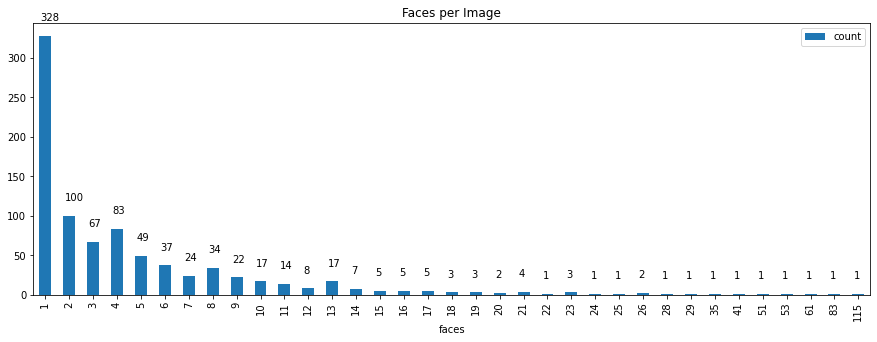

In [12]:
face_dist_df = get_num_faces(df, 'file')

ax = face_dist_df.plot.bar(x='faces', y='count', figsize=(15,5), title='Faces per Image')
for idx, label in enumerate(list(face_dist_df.faces)): 
    val = int(face_dist_df[face_dist_df['faces']==label]['count'])
    ax.annotate(val,
                (idx-0.2, val),
                 xytext=(0, 15), 
                     textcoords='offset points')

In [13]:
print('STD of faces in the images: {:.5}'.format(face_dist_df['count'].std()))

STD of faces in the images: 58.229


## Splitting the Data

The data is very imbalanced, as it has been shown above.  
The number of appearances of each class varies greatly, as well as the amount of faces per image.  
We would like to use Cross-Validation for better training.  
Due to our data being imbalanced, using standard splitting methods can cause some classes to not appear at all in some folds; Moreover, our task involves Multi-label Object Detection, for which the well-known splitting algorithm cannot be used.  
Stratified KFold splits the folds by preserving the percentages of samples for each label.  
`Scikit-learn`'s algorithm cannot be applied to the second problem, so we will utilize the `MultilabelStratifiedKFold` implementation, which can be found [here](https://github.com/trent-b/iterative-stratification).

In [14]:
# self.classes = [None, 'without_mask','with_mask','mask_weared_incorrect']

# MultilabelStratifiedKFold needs to get the Y as binary for each class
x_names = [ name.split('.')[0] for name in x_train ]
y_classes = []
for name in x_names:
    classes = list(df[df['file']==name]['name'].unique())
    indice = np.zeros(4, dtype=np.uint8)
    for c in classes:
        index = testset.classes.index(c)
        indice[index] = 1
    y_classes.append(list(indice))

print(y_classes[:5])


[[0, 0, 1, 0], [0, 0, 1, 0], [0, 0, 1, 0], [0, 0, 1, 0], [0, 0, 1, 0]]


fold 1: train_size=616, test_size=151
fold 2: train_size=613, test_size=154
fold 3: train_size=615, test_size=152
fold 4: train_size=612, test_size=155
fold 5: train_size=612, test_size=155


,fold,class,count
0,1.0,with_mask,2348.0
1,1.0,without_mask,567.0
2,1.0,mask_weared_incorrect,92.0
3,2.0,with_mask,2255.0
4,2.0,without_mask,510.0
5,2.0,mask_weared_incorrect,90.0
6,3.0,with_mask,2383.0
7,3.0,without_mask,483.0
8,3.0,mask_weared_incorrect,87.0
9,4.0,with_mask,2369.0


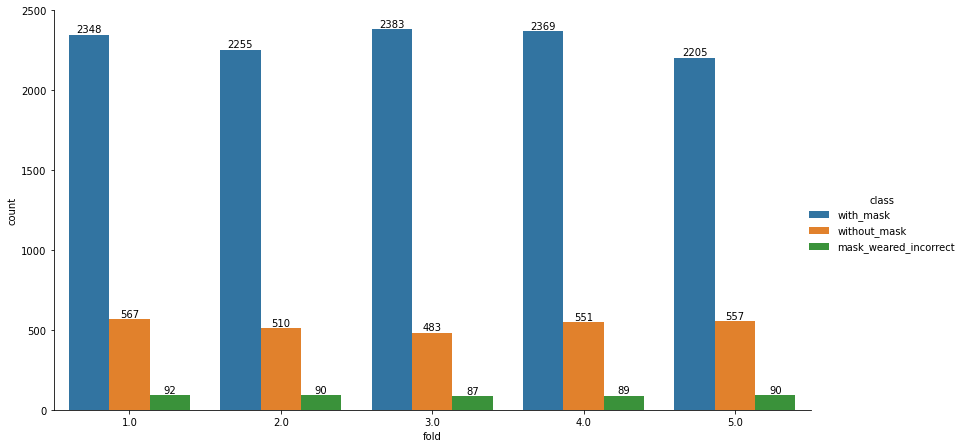

In [15]:
df_folds = pd.DataFrame()
mskf = MultilabelStratifiedKFold(CFG.n_folds)

for fold_id, (train_idx, test_idx) in enumerate(mskf.split(x_names, y_classes), start=1):
    classes = np.zeros(len(testset.classes))
    for idx in train_idx:
        name = x_names[idx]
        for cl, val in df[df['file']==name]['name'].value_counts().to_dict().items():
            class_index = testset.classes.index(cl)
            classes[class_index] += val

    for cl, val in df['name'].value_counts().to_dict().items():
        class_index = testset.classes.index(cl)
        df_folds = df_folds.append({    'fold': int(fold_id),
                                        'class':cl,
                                        'count': classes[class_index] ,
                                        }, ignore_index=True)  

    print('fold {}: train_size={}, test_size={}'.format(fold_id, len(train_idx), len(test_idx)))
    # df_folds = df_folds.append({    'fold': fold_id,
    #                                 'train':    len(train_idx),
    #                                 'valid':    len(test_idx), 
    #                                 'without_mask': classes[testset.classes.index('without_mask')],
    #                                 'with_mask': classes[testset.classes.index('with_mask')],
    #                                 'mask_weared_incorrect': classes[testset.classes.index('mask_weared_incorrect')]
    #                                 }, ignore_index=True)  

display(df_folds)

g = ax = sns.catplot(x='fold', y='count', hue='class', data=df_folds, kind='bar', legend=True)
g.fig.set_size_inches(15, 8)
g.fig.subplots_adjust(top=0.81, right=0.86)

# extract the matplotlib axes_subplot objects from the FacetGrid
ax = g.facet_axis(0, 0)

# iterate through the axes containers
for c in ax.containers:
    labels = [int(v.get_height()) for v in c]
    ax.bar_label(c, labels=labels, label_type='edge')


From the chart above, it can be seen that `MultilabelStratifiedKFold` split the images into almost identical train-test sizes in each fold, while preserving the number of labels from each class within each fold.  

## Data Samples

In [16]:
def norm(img):
    img = np.array(img, dtype=np.float32)
    img -= img.min()
    img /= img.max()
    return img

def get_annotated_img(img, annt, is_pred=False):
    img = norm(np.array(np.transpose(img, (1, 2, 0)))) * 255.0  #   multiple by 255 as in the dataset we divide it
                                                                #   needed here because the image come from the dataset in values of [0, 1]
                                                                #   and the annotations are in values of [0, 255] and plt should get images
                                                                #   with values of [0, 1], therefore a normalizing of the images is needed
        
    num_faces = len(annt['boxes'])
    for i in range(num_faces):
        box, cat = annt['boxes'][i], annt['labels'][i]
        if is_pred:
            score = annt['scores'][i]
        xmin, ymin, xmax, ymax = np.array(box, dtype=np.int32)
        start_point = (xmin, ymin)
        end_point = (xmax, ymax)
        
#         [None, 'without_mask','with_mask','mask_weared_incorrect']
        color = (0, 0, 0)
        if cat == 2:
            color = (0, 255, 0) # green
        elif cat == 3:
            color = (0, 0, 255) # blue
        elif cat == 1:
            color = (255, 0, 0) # red
        thickness = 1
        img = cv2.rectangle(img, start_point, end_point, color, thickness)

        font = cv2.FONT_HERSHEY_SIMPLEX
        fontScale = 1 / 3
        if not is_pred:
            img = cv2.putText(img, '{}'.format(faceMasksData.classes[cat]), start_point, font, fontScale, color = (0, 0, 0), thickness=2)
            img = cv2.putText(img, '{}'.format(faceMasksData.classes[cat]), start_point, font, fontScale, color, thickness)
        else:
            img = cv2.putText(img, '{:.2f}'.format(score), start_point, font, fontScale, color = (0, 0, 0), thickness=2)
            img = cv2.putText(img, '{:.2f}'.format(score), start_point, font, fontScale, color, thickness)

        
        
    return img

def show_augmented_samples(dataloader, model=None):    
    samples, annotations = next(iter(dataloader))   #   get the first batch

    amount_samples = min(12, len(samples))          #   number of examples will be at most 12

    for i, (img, ant) in enumerate(zip(samples, annotations)):
        if i >= amount_samples:
            break
        plt.figure(figsize=(10, 10))
#         plt.subplot(amount_samples, 1, i + 1)        
        img = get_annotated_img(img, ant)
        plt.imshow(norm(img))
        plt.axis('off')
        plt.tight_layout()
        plt.show()

### Real Data Samples

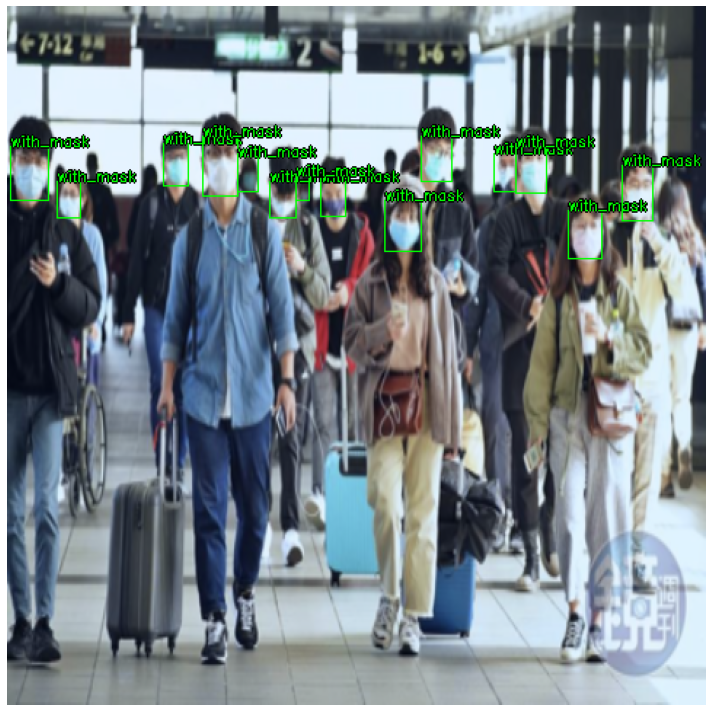

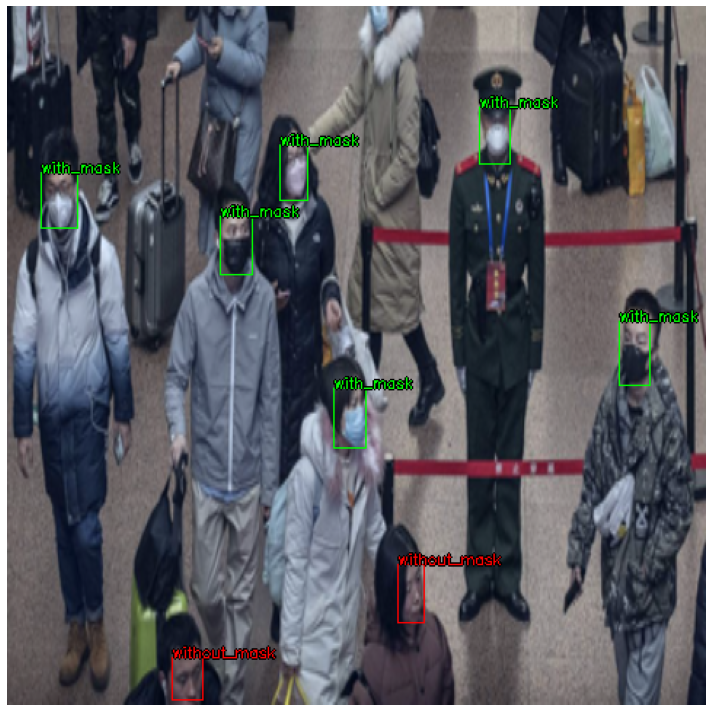

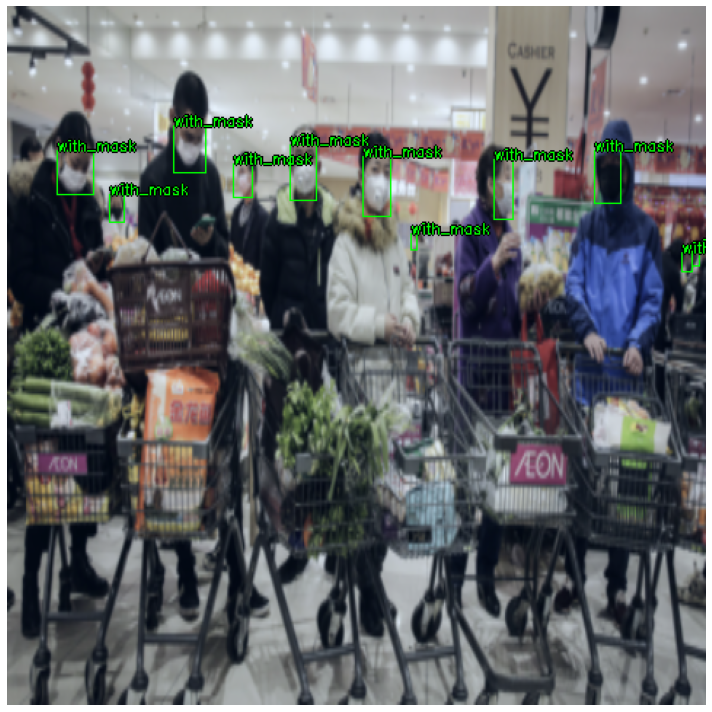

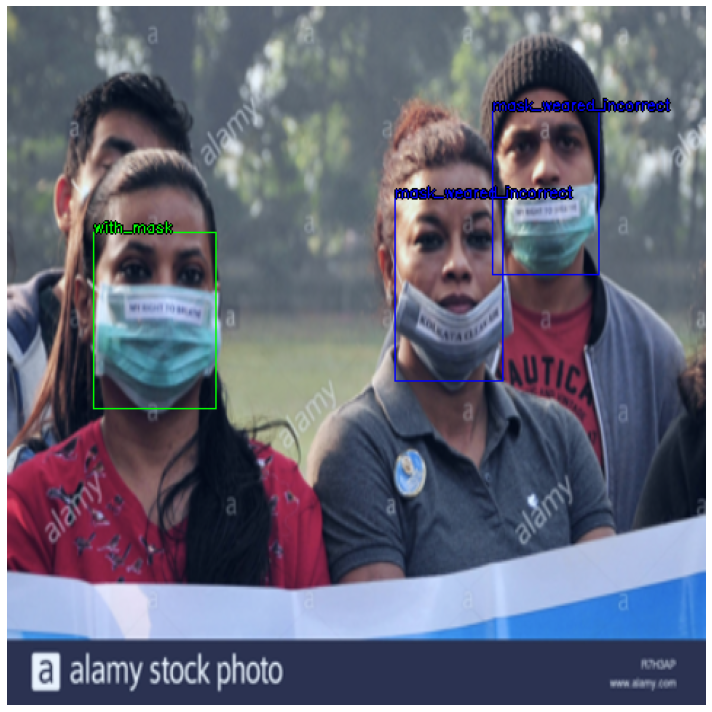

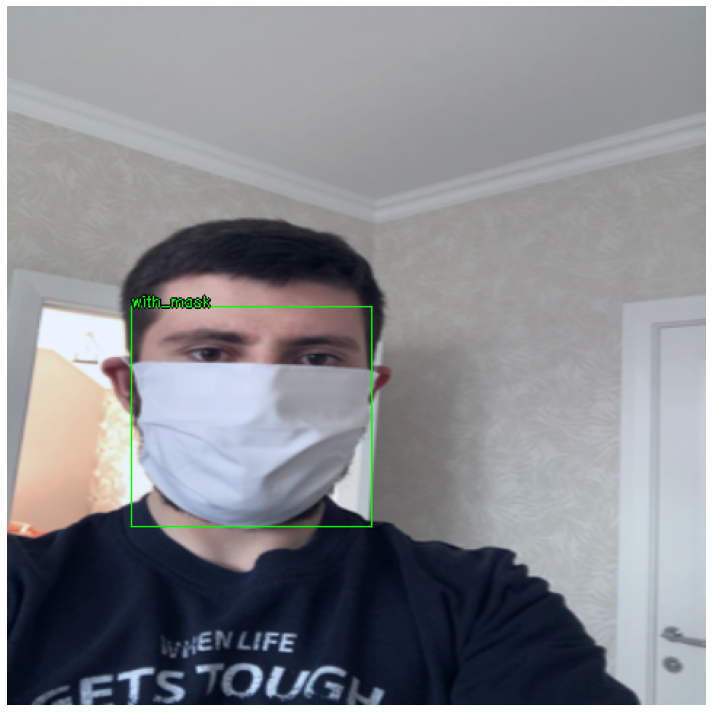

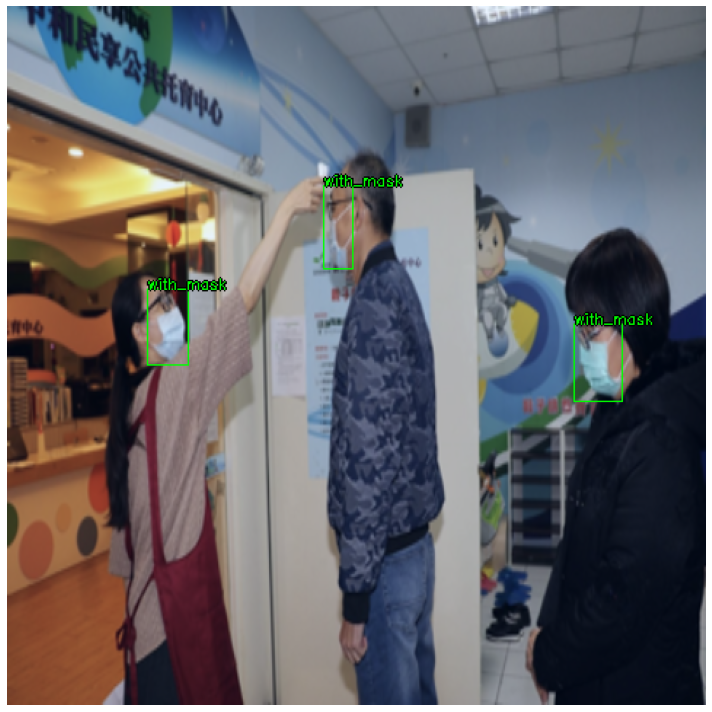

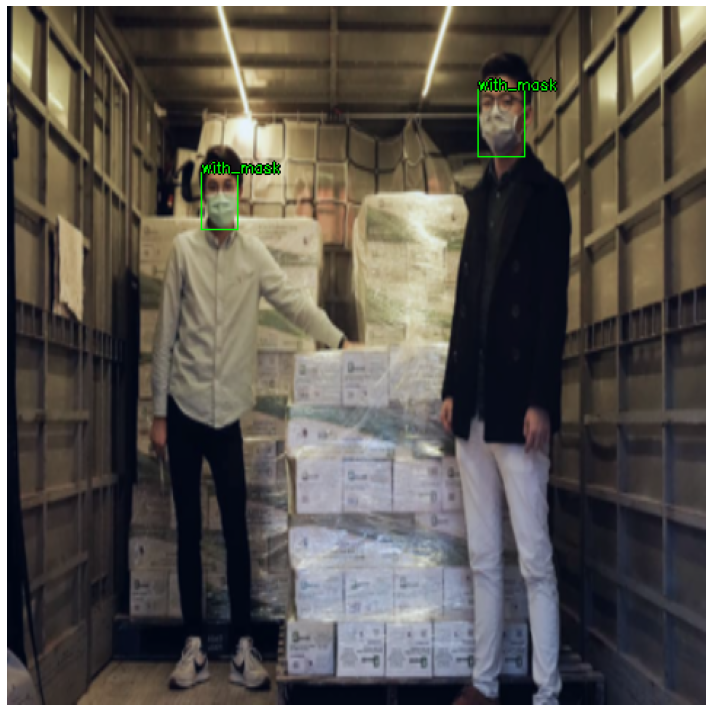

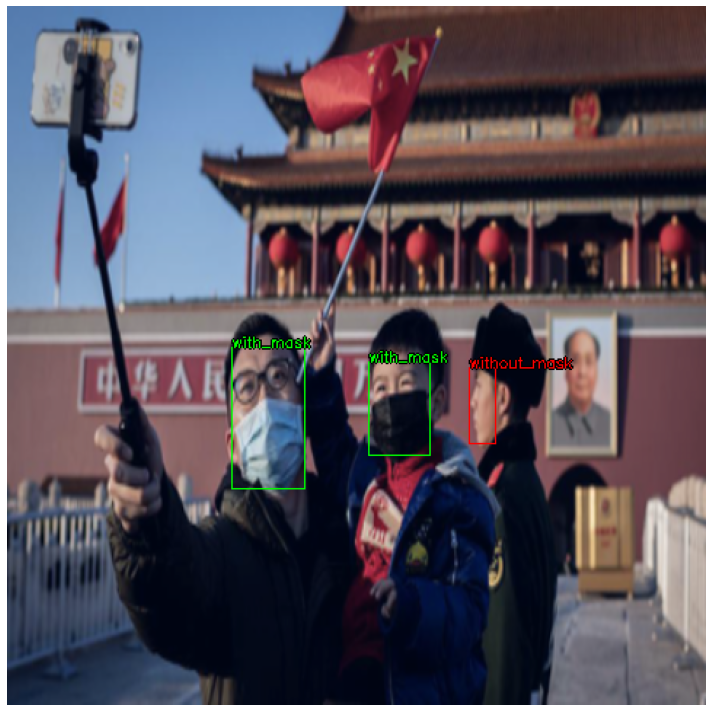

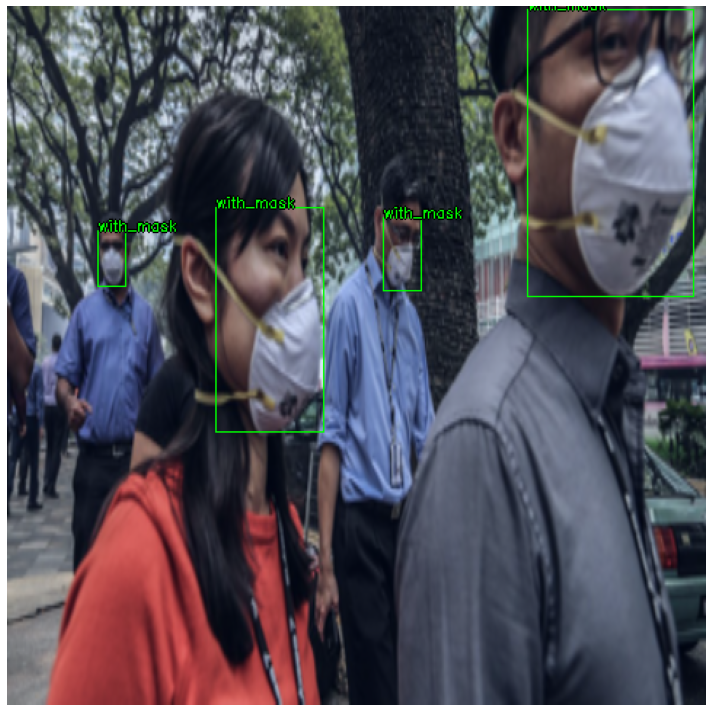

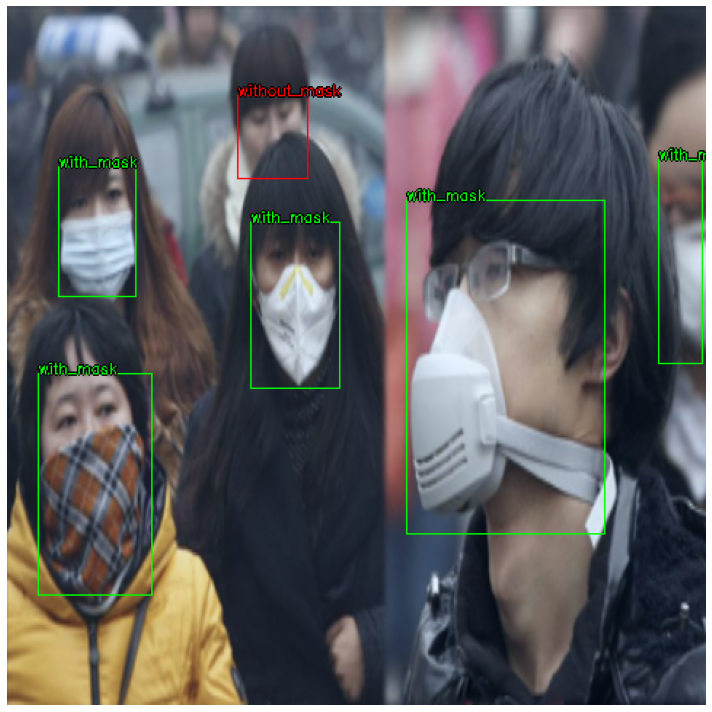

In [17]:
if DEBUG == False:
    show_augmented_samples(test_loader)

### Augmentation Samples

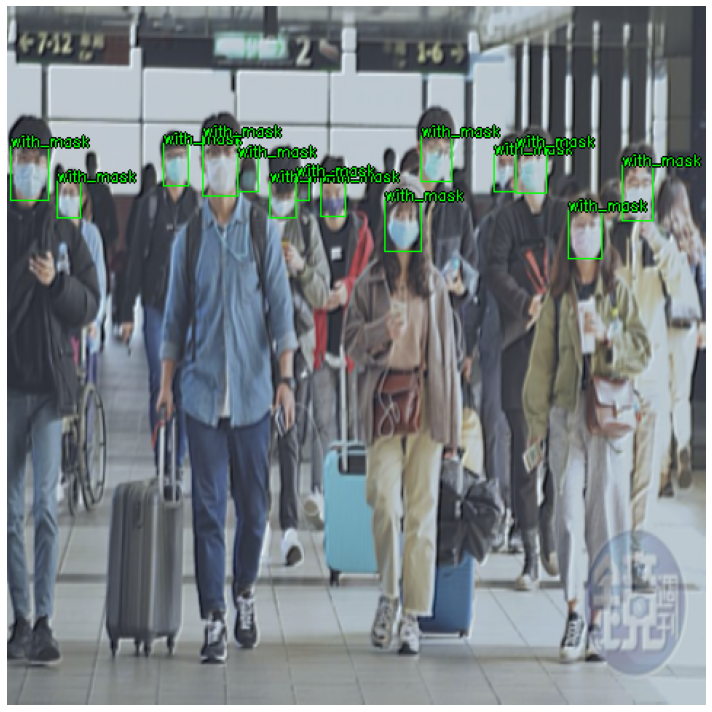

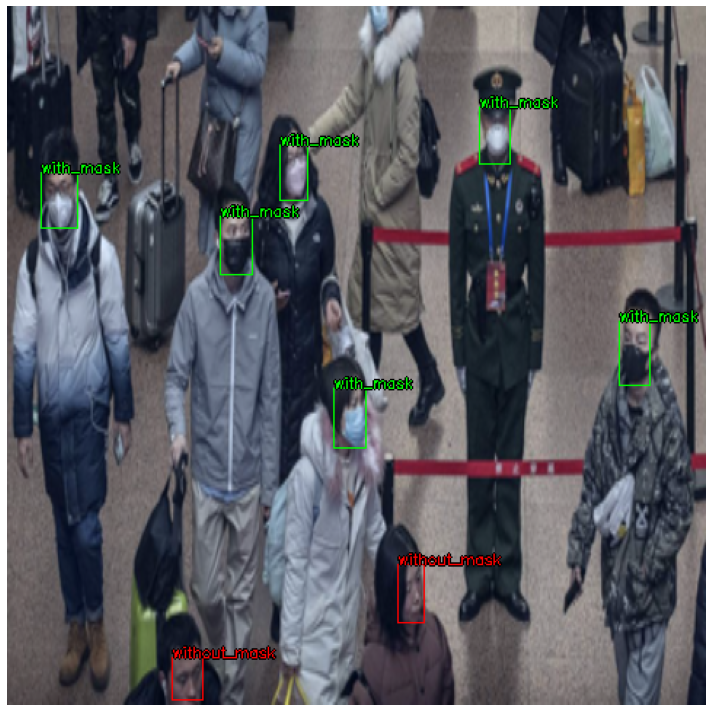

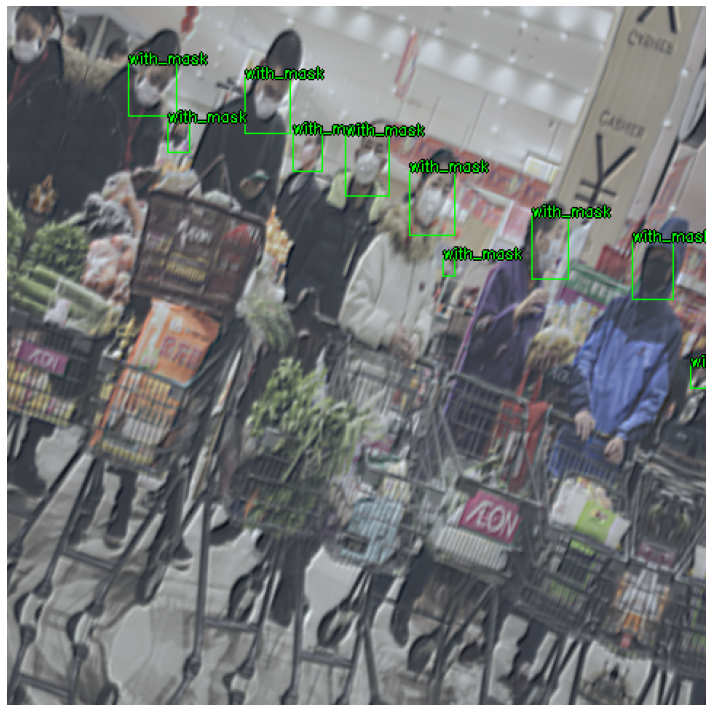

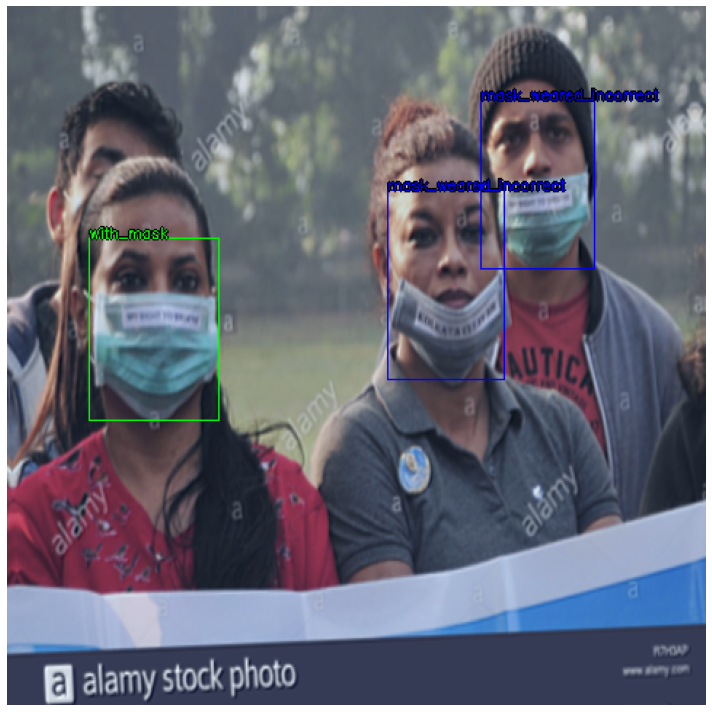

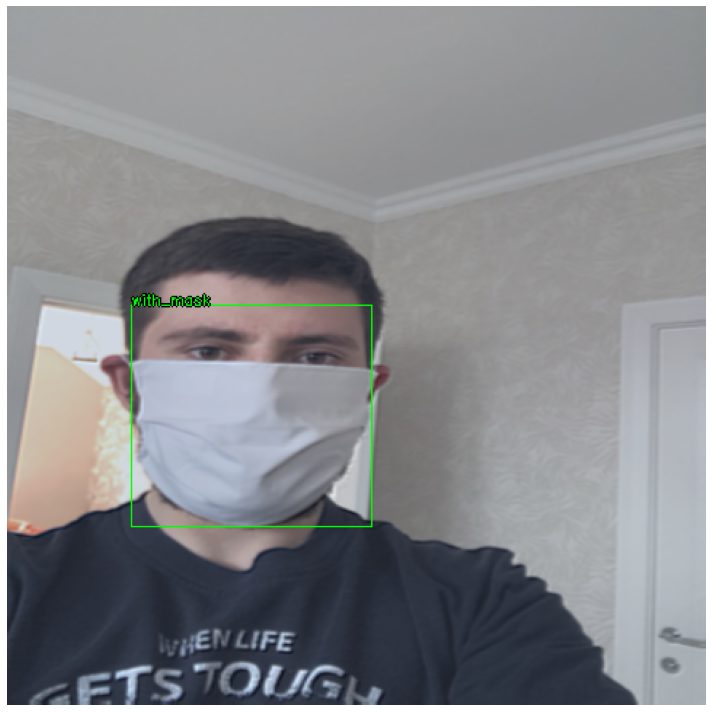

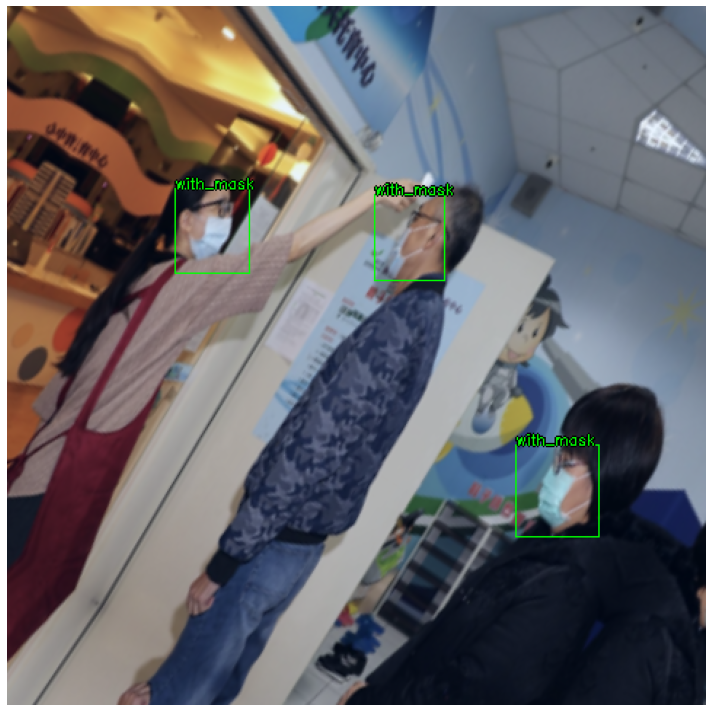

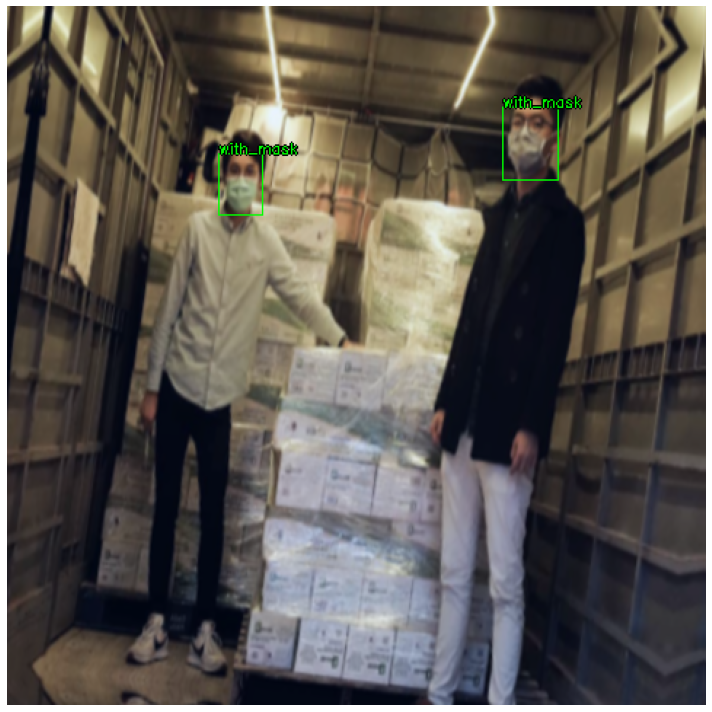

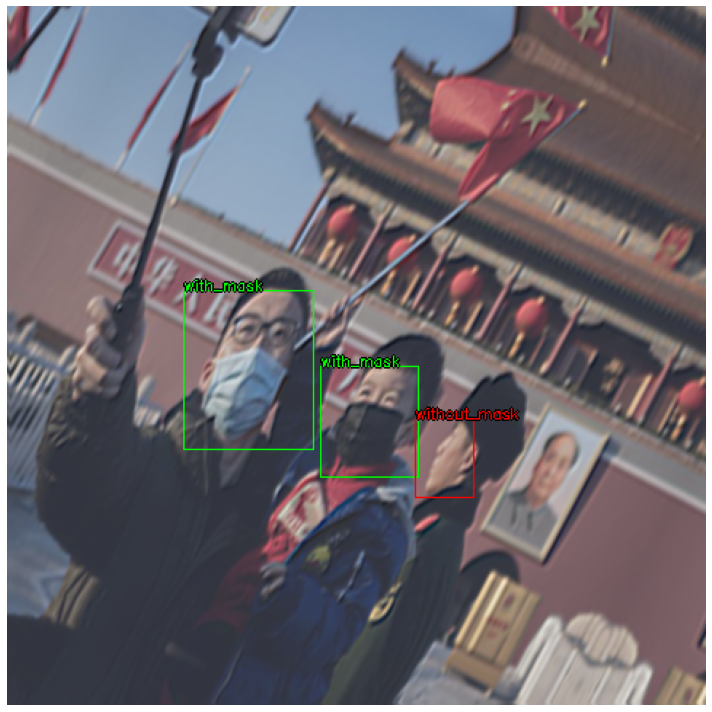

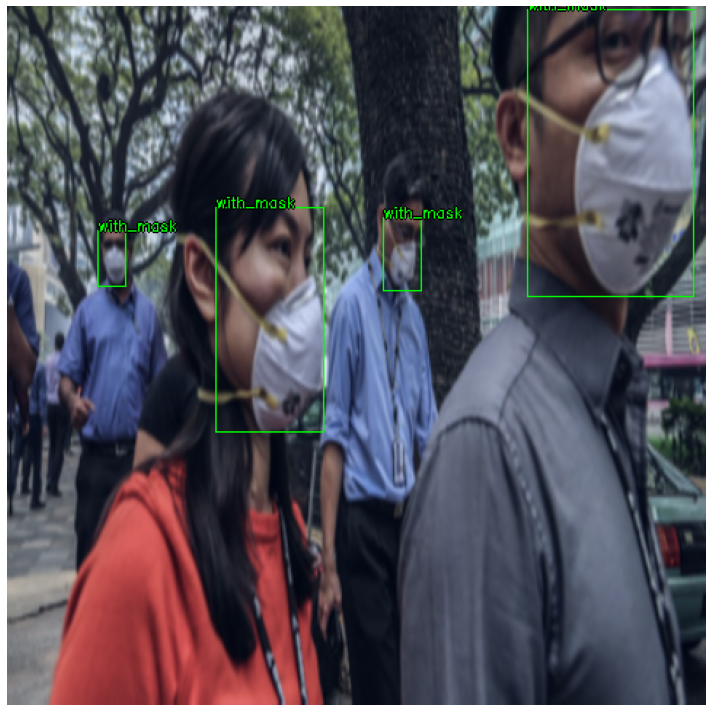

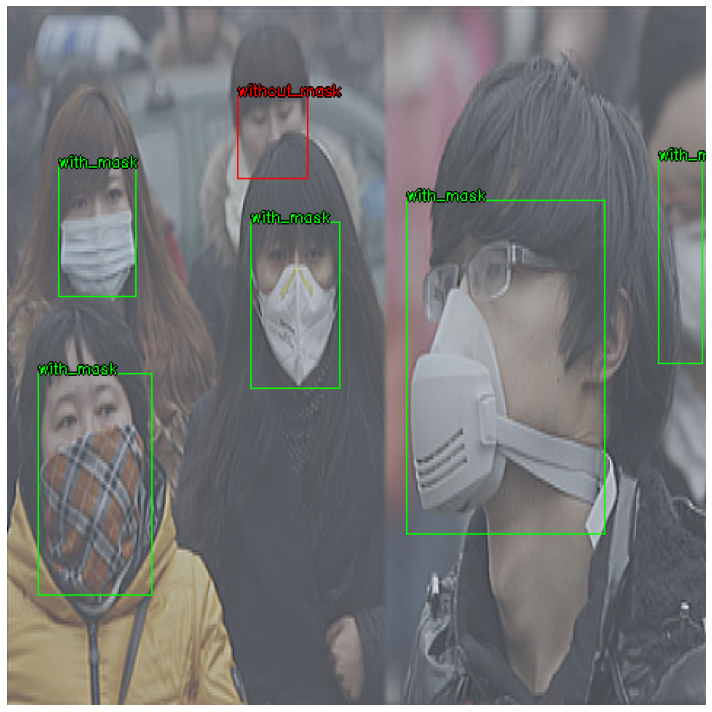

In [18]:
testset = FaceMaskDataset(x_test, y_test, CFG.imgs_path, CFG.msks_path, CFG.img_width, CFG.img_height, transforms=get_transformer('train'))
test_loader = DataLoader(dataset=testset, batch_size=CFG.batch_size, shuffle=False, num_workers=CFG.num_workers, collate_fn=collate_fn)

if DEBUG == False:
    show_augmented_samples(test_loader)

## Training

In [19]:
def get_model(num_classes, pretrained=True):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=pretrained) #   get model
    in_features = model.roi_heads.box_predictor.cls_score.in_features                   #   get input size of last layer
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)         #   regenerate the last layer
    return model

In [20]:
model = get_model(num_classes=CFG.num_classes, pretrained=CFG.pretrained)

# model.roi_heads.fastrcnn_loss = custom_fastrcnn_loss
# torchvision.models.detection.roi_heads.fastrcnn_loss = custom_fastrcnn_loss

In [21]:
datetime_srt = datetime.today().strftime("%d-%m-%y_%H:%M")
run_path = os.path.join(sys.path[0], 'runs', datetime_srt)

In [22]:
if DEBUG == False:
    if CFG.multilabelKFold and CFG.n_folds > 1:
        train(model, x_train, (y_train, l_train), run_path, CFG)
    else:
        train(model, x_train, y_train, run_path, CFG)

This running path is: `/home/linuxgpu/anaconda3/envs/lab1/Face-Mask-Detection/runs/09-11-21_20:49`

Fold 1 of 5
Epoch   1 of 20:


train:   0%|          | 0/62 [00:00<?, ?it/s]/home/linuxgpu/anaconda3/envs/lab1/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1634272204863/work/aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
valid: 100%|██████████| 16/16 [00:11<00:00,  1.43it/s]

train:	loss_classifier=14.55984	loss_box_reg=14.94884	loss_objectness=7.57883	loss_rpn_box_reg=1.70882	total loss=38.79634
valid:	loss_classifier=2.52951	loss_box_reg=3.70048	loss_objectness=0.43461	loss_rpn_box_reg=0.31982	total loss=6.98442


Model saved. Loss < PrevLoss (6.98442 < inf)

Epoch   2 of 20:


valid: 100%|██████████| 16/16 [00:11<00:00,  1.40it/s]

train:	loss_classifier=10.31991	loss_box_reg=15.21334	loss_objectness=1.83208	loss_rpn_box_reg=1.13317	total loss=28.49851
valid:	loss_classifier=1.88260	loss_box_reg=3.19624	loss_objectness=0.39928	loss_rpn_box_reg=0.24210	total loss=5.72021


Model saved. Loss < PrevLoss (5.72021 < 6.98442)

Epoch   3 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.49it/s]

train:	loss_classifier=8.37889	loss_box_reg=13.87635	loss_objectness=1.31881	loss_rpn_box_reg=1.00075	total loss=24.57480
valid:	loss_classifier=1.86610	loss_box_reg=3.14533	loss_objectness=0.28374	loss_rpn_box_reg=0.22568	total loss=5.52086


Model saved. Loss < PrevLoss (5.52086 < 5.72021)

Epoch   4 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=7.99943	loss_box_reg=13.56459	loss_objectness=1.27645	loss_rpn_box_reg=0.86038	total loss=23.70084
valid:	loss_classifier=1.57474	loss_box_reg=2.77011	loss_objectness=0.26650	loss_rpn_box_reg=0.22109	total loss=4.83244


Model saved. Loss < PrevLoss (4.83244 < 5.52086)

Epoch   5 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=7.42718	loss_box_reg=12.46731	loss_objectness=0.97449	loss_rpn_box_reg=0.82367	total loss=21.69265
valid:	loss_classifier=1.61933	loss_box_reg=2.96249	loss_objectness=0.20516	loss_rpn_box_reg=0.22687	total loss=5.01384


Epoch   6 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=6.60729	loss_box_reg=11.55502	loss_objectness=0.77213	loss_rpn_box_reg=0.75366	total loss=19.68809
valid:	loss_classifier=1.52544	loss_box_reg=2.66514	loss_objectness=0.18426	loss_rpn_box_reg=0.19806	total loss=4.57290


Model saved. Loss < PrevLoss (4.57290 < 4.83244)

Epoch   7 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=6.48084	loss_box_reg=11.18433	loss_objectness=0.67169	loss_rpn_box_reg=0.70574	total loss=19.04260
valid:	loss_classifier=1.51454	loss_box_reg=2.66865	loss_objectness=0.18496	loss_rpn_box_reg=0.19349	total loss=4.56163


Model saved. Loss < PrevLoss (4.56163 < 4.57290)

Epoch   8 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=6.36256	loss_box_reg=11.12686	loss_objectness=0.60876	loss_rpn_box_reg=0.64691	total loss=18.74509
valid:	loss_classifier=1.49312	loss_box_reg=2.64090	loss_objectness=0.18642	loss_rpn_box_reg=0.19516	total loss=4.51560


Model saved. Loss < PrevLoss (4.51560 < 4.56163)

Epoch   9 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.49383	loss_box_reg=11.26893	loss_objectness=0.64274	loss_rpn_box_reg=0.63443	total loss=19.03992
valid:	loss_classifier=1.52493	loss_box_reg=2.67580	loss_objectness=0.22352	loss_rpn_box_reg=0.19233	total loss=4.61657


Epoch  10 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.42897	loss_box_reg=11.21191	loss_objectness=0.68523	loss_rpn_box_reg=0.70564	total loss=19.03175
valid:	loss_classifier=1.55092	loss_box_reg=2.81906	loss_objectness=0.18899	loss_rpn_box_reg=0.20040	total loss=4.75938


Epoch  11 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=6.46314	loss_box_reg=11.24431	loss_objectness=0.63966	loss_rpn_box_reg=0.66912	total loss=19.01622
valid:	loss_classifier=1.50922	loss_box_reg=2.66300	loss_objectness=0.20616	loss_rpn_box_reg=0.19196	total loss=4.57034


Epoch  12 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=6.36753	loss_box_reg=10.99467	loss_objectness=0.59974	loss_rpn_box_reg=0.67159	total loss=18.63354
valid:	loss_classifier=1.48818	loss_box_reg=2.68145	loss_objectness=0.20885	loss_rpn_box_reg=0.19247	total loss=4.57095


Epoch  13 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=6.16429	loss_box_reg=11.06495	loss_objectness=0.64548	loss_rpn_box_reg=0.66106	total loss=18.53579
valid:	loss_classifier=1.50100	loss_box_reg=2.68242	loss_objectness=0.19746	loss_rpn_box_reg=0.19333	total loss=4.57421


Epoch  14 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.30050	loss_box_reg=11.04009	loss_objectness=0.61786	loss_rpn_box_reg=0.63727	total loss=18.59573
valid:	loss_classifier=1.49688	loss_box_reg=2.70135	loss_objectness=0.19851	loss_rpn_box_reg=0.19258	total loss=4.58932


Epoch  15 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=6.16774	loss_box_reg=10.89944	loss_objectness=0.53491	loss_rpn_box_reg=0.65406	total loss=18.25616
valid:	loss_classifier=1.49507	loss_box_reg=2.63868	loss_objectness=0.21180	loss_rpn_box_reg=0.18905	total loss=4.53459


Epoch  16 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=6.41260	loss_box_reg=11.02292	loss_objectness=0.63147	loss_rpn_box_reg=0.63893	total loss=18.70592
valid:	loss_classifier=1.48150	loss_box_reg=2.63900	loss_objectness=0.20336	loss_rpn_box_reg=0.19214	total loss=4.51600


Epoch  17 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=6.33803	loss_box_reg=11.31839	loss_objectness=0.59926	loss_rpn_box_reg=0.64637	total loss=18.90205
valid:	loss_classifier=1.48851	loss_box_reg=2.64537	loss_objectness=0.19744	loss_rpn_box_reg=0.19368	total loss=4.52499


Epoch  18 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.17073	loss_box_reg=11.04405	loss_objectness=0.59753	loss_rpn_box_reg=0.67411	total loss=18.48641
valid:	loss_classifier=1.49577	loss_box_reg=2.64654	loss_objectness=0.20144	loss_rpn_box_reg=0.19270	total loss=4.53645


Epoch  19 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

train:	loss_classifier=6.31196	loss_box_reg=11.08092	loss_objectness=0.64887	loss_rpn_box_reg=0.64354	total loss=18.68528
valid:	loss_classifier=1.50889	loss_box_reg=2.65763	loss_objectness=0.20364	loss_rpn_box_reg=0.18930	total loss=4.55947


Epoch  20 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=6.28305	loss_box_reg=10.92692	loss_objectness=0.59834	loss_rpn_box_reg=0.65377	total loss=18.46208
valid:	loss_classifier=1.49762	loss_box_reg=2.64607	loss_objectness=0.21274	loss_rpn_box_reg=0.19294	total loss=4.54937


Fold 2 of 5
Epoch   1 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.81814	loss_box_reg=11.67234	loss_objectness=0.71450	loss_rpn_box_reg=0.69237	total loss=19.89735
valid:	loss_classifier=1.52259	loss_box_reg=2.84186	loss_objectness=0.21646	loss_rpn_box_reg=0.21484	total loss=4.79574


Epoch   2 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=6.42684	loss_box_reg=11.18179	loss_objectness=0.69653	loss_rpn_box_reg=0.61717	total loss=18.92233
valid:	loss_classifier=1.58965	loss_box_reg=3.08537	loss_objectness=0.13274	loss_rpn_box_reg=0.21907	total loss=5.02683


Epoch   3 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=6.16551	loss_box_reg=11.32156	loss_objectness=0.61722	loss_rpn_box_reg=0.62915	total loss=18.73344
valid:	loss_classifier=1.50763	loss_box_reg=3.20170	loss_objectness=0.11712	loss_rpn_box_reg=0.26398	total loss=5.09043


Epoch   4 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

train:	loss_classifier=6.29596	loss_box_reg=11.27375	loss_objectness=0.61891	loss_rpn_box_reg=0.60353	total loss=18.79215
valid:	loss_classifier=1.44440	loss_box_reg=2.73941	loss_objectness=0.12655	loss_rpn_box_reg=0.22657	total loss=4.53692


Epoch   5 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

train:	loss_classifier=6.06435	loss_box_reg=10.73738	loss_objectness=0.56822	loss_rpn_box_reg=0.58929	total loss=17.95924
valid:	loss_classifier=1.54106	loss_box_reg=3.43084	loss_objectness=0.12239	loss_rpn_box_reg=0.24453	total loss=5.33882


Epoch   6 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=5.36201	loss_box_reg=9.56199	loss_objectness=0.41353	loss_rpn_box_reg=0.53422	total loss=15.87174
valid:	loss_classifier=1.38374	loss_box_reg=2.71180	loss_objectness=0.12191	loss_rpn_box_reg=0.21607	total loss=4.43352


Model saved. Loss < PrevLoss (4.43352 < 4.51560)

Epoch   7 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=5.35620	loss_box_reg=9.62900	loss_objectness=0.41985	loss_rpn_box_reg=0.50166	total loss=15.90671
valid:	loss_classifier=1.36137	loss_box_reg=2.64834	loss_objectness=0.11545	loss_rpn_box_reg=0.21180	total loss=4.33696


Model saved. Loss < PrevLoss (4.33696 < 4.43352)

Epoch   8 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=5.15339	loss_box_reg=9.48356	loss_objectness=0.49098	loss_rpn_box_reg=0.54373	total loss=15.67166
valid:	loss_classifier=1.35071	loss_box_reg=2.66201	loss_objectness=0.12730	loss_rpn_box_reg=0.21328	total loss=4.35331


Epoch   9 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=5.22334	loss_box_reg=9.46209	loss_objectness=0.40369	loss_rpn_box_reg=0.48905	total loss=15.57816
valid:	loss_classifier=1.34566	loss_box_reg=2.72925	loss_objectness=0.11519	loss_rpn_box_reg=0.22071	total loss=4.41081


Epoch  10 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=5.25994	loss_box_reg=9.45002	loss_objectness=0.47393	loss_rpn_box_reg=0.50827	total loss=15.69216
valid:	loss_classifier=1.38197	loss_box_reg=2.76685	loss_objectness=0.12503	loss_rpn_box_reg=0.22647	total loss=4.50033


Epoch  11 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=5.05451	loss_box_reg=9.28040	loss_objectness=0.37193	loss_rpn_box_reg=0.49666	total loss=15.20350
valid:	loss_classifier=1.36208	loss_box_reg=2.67029	loss_objectness=0.12392	loss_rpn_box_reg=0.21212	total loss=4.36841


Epoch  12 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=5.17243	loss_box_reg=9.45861	loss_objectness=0.42570	loss_rpn_box_reg=0.49943	total loss=15.55616
valid:	loss_classifier=1.34324	loss_box_reg=2.67248	loss_objectness=0.10810	loss_rpn_box_reg=0.21374	total loss=4.33756


Epoch  13 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=5.09986	loss_box_reg=9.46279	loss_objectness=0.45588	loss_rpn_box_reg=0.48156	total loss=15.50010
valid:	loss_classifier=1.34182	loss_box_reg=2.67871	loss_objectness=0.11912	loss_rpn_box_reg=0.21502	total loss=4.35467


Epoch  14 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.96293	loss_box_reg=9.29894	loss_objectness=0.45479	loss_rpn_box_reg=0.51750	total loss=15.23416
valid:	loss_classifier=1.38179	loss_box_reg=2.72603	loss_objectness=0.12204	loss_rpn_box_reg=0.22164	total loss=4.45150


Epoch  15 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.93508	loss_box_reg=9.12708	loss_objectness=0.38756	loss_rpn_box_reg=0.47872	total loss=14.92844
valid:	loss_classifier=1.37108	loss_box_reg=2.67638	loss_objectness=0.11827	loss_rpn_box_reg=0.21879	total loss=4.38453


Epoch  16 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.92323	loss_box_reg=9.08934	loss_objectness=0.39607	loss_rpn_box_reg=0.48447	total loss=14.89312
valid:	loss_classifier=1.36178	loss_box_reg=2.68203	loss_objectness=0.10965	loss_rpn_box_reg=0.21472	total loss=4.36817


Epoch  17 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=5.16750	loss_box_reg=9.39665	loss_objectness=0.42634	loss_rpn_box_reg=0.46196	total loss=15.45245
valid:	loss_classifier=1.35160	loss_box_reg=2.68737	loss_objectness=0.12157	loss_rpn_box_reg=0.21558	total loss=4.37611


Epoch  18 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=5.11507	loss_box_reg=9.24839	loss_objectness=0.48113	loss_rpn_box_reg=0.50711	total loss=15.35169
valid:	loss_classifier=1.37616	loss_box_reg=2.68389	loss_objectness=0.11311	loss_rpn_box_reg=0.21346	total loss=4.38661


Epoch  19 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=5.02759	loss_box_reg=9.02574	loss_objectness=0.38890	loss_rpn_box_reg=0.47150	total loss=14.91373
valid:	loss_classifier=1.34483	loss_box_reg=2.67535	loss_objectness=0.12299	loss_rpn_box_reg=0.22083	total loss=4.36401


Epoch  20 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=5.10216	loss_box_reg=9.46653	loss_objectness=0.40348	loss_rpn_box_reg=0.53256	total loss=15.50472
valid:	loss_classifier=1.34559	loss_box_reg=2.69263	loss_objectness=0.12516	loss_rpn_box_reg=0.21452	total loss=4.37791


Fold 3 of 5
Epoch   1 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=5.29630	loss_box_reg=10.05864	loss_objectness=0.48215	loss_rpn_box_reg=0.60266	total loss=16.43974
valid:	loss_classifier=1.21952	loss_box_reg=2.43896	loss_objectness=0.09098	loss_rpn_box_reg=0.20272	total loss=3.95218


Model saved. Loss < PrevLoss (3.95218 < 4.33696)

Epoch   2 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=5.17768	loss_box_reg=10.32614	loss_objectness=0.42926	loss_rpn_box_reg=0.56119	total loss=16.49428
valid:	loss_classifier=1.31547	loss_box_reg=3.04749	loss_objectness=0.08677	loss_rpn_box_reg=0.20489	total loss=4.65461


Epoch   3 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=5.17384	loss_box_reg=9.98724	loss_objectness=0.42308	loss_rpn_box_reg=0.55610	total loss=16.14026
valid:	loss_classifier=1.33611	loss_box_reg=2.72164	loss_objectness=0.09014	loss_rpn_box_reg=0.18419	total loss=4.33209


Epoch   4 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]


train:	loss_classifier=5.12655	loss_box_reg=10.06167	loss_objectness=0.38585	loss_rpn_box_reg=0.54894	total loss=16.12301
valid:	loss_classifier=1.40101	loss_box_reg=2.74668	loss_objectness=0.09026	loss_rpn_box_reg=0.22735	total loss=4.46530
Epoch   5 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=5.02072	loss_box_reg=9.84159	loss_objectness=0.46280	loss_rpn_box_reg=0.54545	total loss=15.87056
valid:	loss_classifier=1.28565	loss_box_reg=2.50110	loss_objectness=0.10377	loss_rpn_box_reg=0.17978	total loss=4.07030


Epoch   6 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.56205	loss_box_reg=8.83081	loss_objectness=0.41739	loss_rpn_box_reg=0.47118	total loss=14.28143
valid:	loss_classifier=1.22286	loss_box_reg=2.39532	loss_objectness=0.09660	loss_rpn_box_reg=0.16503	total loss=3.87982


Model saved. Loss < PrevLoss (3.87982 < 3.95218)

Epoch   7 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.31234	loss_box_reg=8.68379	loss_objectness=0.35495	loss_rpn_box_reg=0.47466	total loss=13.82574
valid:	loss_classifier=1.21976	loss_box_reg=2.40189	loss_objectness=0.08253	loss_rpn_box_reg=0.16665	total loss=3.87083


Model saved. Loss < PrevLoss (3.87083 < 3.87982)

Epoch   8 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.38207	loss_box_reg=8.63387	loss_objectness=0.29640	loss_rpn_box_reg=0.45453	total loss=13.76688
valid:	loss_classifier=1.23222	loss_box_reg=2.42774	loss_objectness=0.08264	loss_rpn_box_reg=0.17077	total loss=3.91337


Epoch   9 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.17644	loss_box_reg=8.62865	loss_objectness=0.30108	loss_rpn_box_reg=0.44456	total loss=13.55073
valid:	loss_classifier=1.24046	loss_box_reg=2.45912	loss_objectness=0.09591	loss_rpn_box_reg=0.16995	total loss=3.96544


Epoch  10 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.24148	loss_box_reg=8.56676	loss_objectness=0.34705	loss_rpn_box_reg=0.47793	total loss=13.63322
valid:	loss_classifier=1.20491	loss_box_reg=2.44213	loss_objectness=0.08674	loss_rpn_box_reg=0.16969	total loss=3.90347


Epoch  11 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

train:	loss_classifier=4.11093	loss_box_reg=8.44191	loss_objectness=0.34525	loss_rpn_box_reg=0.43974	total loss=13.33783
valid:	loss_classifier=1.20295	loss_box_reg=2.39838	loss_objectness=0.08311	loss_rpn_box_reg=0.17149	total loss=3.85593


Model saved. Loss < PrevLoss (3.85593 < 3.87083)

Epoch  12 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.18013	loss_box_reg=8.41082	loss_objectness=0.31653	loss_rpn_box_reg=0.41583	total loss=13.32331
valid:	loss_classifier=1.18960	loss_box_reg=2.36876	loss_objectness=0.08126	loss_rpn_box_reg=0.16771	total loss=3.80733


Model saved. Loss < PrevLoss (3.80733 < 3.85593)

Epoch  13 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.32926	loss_box_reg=8.49101	loss_objectness=0.35807	loss_rpn_box_reg=0.42594	total loss=13.60427
valid:	loss_classifier=1.18774	loss_box_reg=2.36607	loss_objectness=0.07944	loss_rpn_box_reg=0.16925	total loss=3.80249


Model saved. Loss < PrevLoss (3.80249 < 3.80733)

Epoch  14 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.40295	loss_box_reg=8.53910	loss_objectness=0.28315	loss_rpn_box_reg=0.45611	total loss=13.68131
valid:	loss_classifier=1.20161	loss_box_reg=2.40475	loss_objectness=0.08713	loss_rpn_box_reg=0.16986	total loss=3.86335


Epoch  15 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.24205	loss_box_reg=8.61536	loss_objectness=0.35154	loss_rpn_box_reg=0.45784	total loss=13.66680
valid:	loss_classifier=1.20190	loss_box_reg=2.36636	loss_objectness=0.08611	loss_rpn_box_reg=0.16832	total loss=3.82269


Epoch  16 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.19732	loss_box_reg=8.44667	loss_objectness=0.29993	loss_rpn_box_reg=0.45241	total loss=13.39634
valid:	loss_classifier=1.19025	loss_box_reg=2.38040	loss_objectness=0.07774	loss_rpn_box_reg=0.17157	total loss=3.81996


Epoch  17 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.18506	loss_box_reg=8.37908	loss_objectness=0.26500	loss_rpn_box_reg=0.44673	total loss=13.27588
valid:	loss_classifier=1.22286	loss_box_reg=2.37353	loss_objectness=0.08683	loss_rpn_box_reg=0.16709	total loss=3.85030


Epoch  18 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.15906	loss_box_reg=8.27909	loss_objectness=0.29277	loss_rpn_box_reg=0.41898	total loss=13.14991
valid:	loss_classifier=1.22118	loss_box_reg=2.37414	loss_objectness=0.08969	loss_rpn_box_reg=0.16601	total loss=3.85102


Epoch  19 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

train:	loss_classifier=4.40226	loss_box_reg=8.40437	loss_objectness=0.30971	loss_rpn_box_reg=0.43458	total loss=13.55091
valid:	loss_classifier=1.19229	loss_box_reg=2.38534	loss_objectness=0.08976	loss_rpn_box_reg=0.16778	total loss=3.83517


Epoch  20 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.27569	loss_box_reg=8.51250	loss_objectness=0.38033	loss_rpn_box_reg=0.44488	total loss=13.61340
valid:	loss_classifier=1.21717	loss_box_reg=2.38471	loss_objectness=0.09314	loss_rpn_box_reg=0.16964	total loss=3.86466


Fold 4 of 5
Epoch   1 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=5.01045	loss_box_reg=9.78068	loss_objectness=0.44959	loss_rpn_box_reg=0.55807	total loss=15.79880
valid:	loss_classifier=0.93051	loss_box_reg=1.85362	loss_objectness=0.04986	loss_rpn_box_reg=0.09816	total loss=2.93216


Model saved. Loss < PrevLoss (2.93216 < 3.80249)

Epoch   2 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.99632	loss_box_reg=9.90219	loss_objectness=0.44928	loss_rpn_box_reg=0.56473	total loss=15.91252
valid:	loss_classifier=0.85634	loss_box_reg=2.03114	loss_objectness=0.05460	loss_rpn_box_reg=0.11332	total loss=3.05539


Epoch   3 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=4.93038	loss_box_reg=10.05001	loss_objectness=0.47636	loss_rpn_box_reg=0.61745	total loss=16.07420
valid:	loss_classifier=0.93626	loss_box_reg=2.03956	loss_objectness=0.05904	loss_rpn_box_reg=0.11790	total loss=3.15275


Epoch   4 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=4.84155	loss_box_reg=9.43750	loss_objectness=0.36683	loss_rpn_box_reg=0.56536	total loss=15.21124
valid:	loss_classifier=0.88835	loss_box_reg=1.94999	loss_objectness=0.05383	loss_rpn_box_reg=0.12534	total loss=3.01752


Epoch   5 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=4.74613	loss_box_reg=9.86788	loss_objectness=0.38734	loss_rpn_box_reg=0.59772	total loss=15.59908
valid:	loss_classifier=0.92606	loss_box_reg=1.96283	loss_objectness=0.06114	loss_rpn_box_reg=0.10738	total loss=3.05741


Epoch   6 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=4.34204	loss_box_reg=8.62916	loss_objectness=0.32403	loss_rpn_box_reg=0.49322	total loss=13.78844
valid:	loss_classifier=0.86444	loss_box_reg=1.88869	loss_objectness=0.05894	loss_rpn_box_reg=0.09708	total loss=2.90915


Model saved. Loss < PrevLoss (2.90915 < 2.93216)

Epoch   7 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.29596	loss_box_reg=8.85147	loss_objectness=0.37958	loss_rpn_box_reg=0.51758	total loss=14.04461
valid:	loss_classifier=0.83501	loss_box_reg=1.77094	loss_objectness=0.04967	loss_rpn_box_reg=0.09526	total loss=2.75088


Model saved. Loss < PrevLoss (2.75088 < 2.90915)

Epoch   8 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=4.27485	loss_box_reg=8.44950	loss_objectness=0.31232	loss_rpn_box_reg=0.45110	total loss=13.48777
valid:	loss_classifier=0.81911	loss_box_reg=1.76916	loss_objectness=0.04457	loss_rpn_box_reg=0.09199	total loss=2.72483


Model saved. Loss < PrevLoss (2.72483 < 2.75088)

Epoch   9 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

train:	loss_classifier=4.08536	loss_box_reg=8.48752	loss_objectness=0.30272	loss_rpn_box_reg=0.45049	total loss=13.32610
valid:	loss_classifier=0.81484	loss_box_reg=1.81223	loss_objectness=0.04067	loss_rpn_box_reg=0.09072	total loss=2.75846


Epoch  10 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=4.30853	loss_box_reg=8.45487	loss_objectness=0.31926	loss_rpn_box_reg=0.47008	total loss=13.55274
valid:	loss_classifier=0.83762	loss_box_reg=1.80864	loss_objectness=0.04118	loss_rpn_box_reg=0.09237	total loss=2.77981


Epoch  11 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

train:	loss_classifier=4.26765	loss_box_reg=8.53749	loss_objectness=0.28034	loss_rpn_box_reg=0.45764	total loss=13.54312
valid:	loss_classifier=0.82711	loss_box_reg=1.78607	loss_objectness=0.04394	loss_rpn_box_reg=0.09273	total loss=2.74985


Epoch  12 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=3.98940	loss_box_reg=8.27722	loss_objectness=0.29300	loss_rpn_box_reg=0.43633	total loss=12.99593
valid:	loss_classifier=0.80736	loss_box_reg=1.78185	loss_objectness=0.04675	loss_rpn_box_reg=0.09183	total loss=2.72779


Epoch  13 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=4.33019	loss_box_reg=8.51491	loss_objectness=0.28869	loss_rpn_box_reg=0.47466	total loss=13.60845
valid:	loss_classifier=0.80979	loss_box_reg=1.79134	loss_objectness=0.04956	loss_rpn_box_reg=0.09283	total loss=2.74352


Epoch  14 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.01974	loss_box_reg=8.22312	loss_objectness=0.29367	loss_rpn_box_reg=0.45659	total loss=12.99311
valid:	loss_classifier=0.82477	loss_box_reg=1.78684	loss_objectness=0.04330	loss_rpn_box_reg=0.09092	total loss=2.74583


Epoch  15 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.50it/s]

train:	loss_classifier=4.10931	loss_box_reg=8.23071	loss_objectness=0.31868	loss_rpn_box_reg=0.46261	total loss=13.12131
valid:	loss_classifier=0.82687	loss_box_reg=1.77465	loss_objectness=0.04676	loss_rpn_box_reg=0.09016	total loss=2.73843


Epoch  16 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.11051	loss_box_reg=8.19198	loss_objectness=0.30949	loss_rpn_box_reg=0.43948	total loss=13.05147
valid:	loss_classifier=0.81724	loss_box_reg=1.77781	loss_objectness=0.04473	loss_rpn_box_reg=0.09044	total loss=2.73023


Epoch  17 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=4.28086	loss_box_reg=8.38024	loss_objectness=0.30397	loss_rpn_box_reg=0.44733	total loss=13.41239
valid:	loss_classifier=0.80994	loss_box_reg=1.77486	loss_objectness=0.05051	loss_rpn_box_reg=0.09075	total loss=2.72606


Epoch  18 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.33978	loss_box_reg=8.58205	loss_objectness=0.35799	loss_rpn_box_reg=0.48077	total loss=13.76059
valid:	loss_classifier=0.80758	loss_box_reg=1.77697	loss_objectness=0.04526	loss_rpn_box_reg=0.09157	total loss=2.72138


Model saved. Loss < PrevLoss (2.72138 < 2.72483)

Epoch  19 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=4.11305	loss_box_reg=8.32378	loss_objectness=0.31888	loss_rpn_box_reg=0.47125	total loss=13.22696
valid:	loss_classifier=0.82873	loss_box_reg=1.77459	loss_objectness=0.04346	loss_rpn_box_reg=0.09185	total loss=2.73863


Epoch  20 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.51it/s]

train:	loss_classifier=3.98643	loss_box_reg=8.23501	loss_objectness=0.29916	loss_rpn_box_reg=0.44082	total loss=12.96142
valid:	loss_classifier=0.81920	loss_box_reg=1.77603	loss_objectness=0.04569	loss_rpn_box_reg=0.09165	total loss=2.73257


Fold 5 of 5
Epoch   1 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=4.75750	loss_box_reg=9.90629	loss_objectness=0.40213	loss_rpn_box_reg=0.56773	total loss=15.63364
valid:	loss_classifier=0.81628	loss_box_reg=1.94861	loss_objectness=0.02717	loss_rpn_box_reg=0.08378	total loss=2.87585


Epoch   2 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.58it/s]

train:	loss_classifier=4.64836	loss_box_reg=9.66521	loss_objectness=0.45440	loss_rpn_box_reg=0.59994	total loss=15.36791
valid:	loss_classifier=0.73029	loss_box_reg=1.65242	loss_objectness=0.03310	loss_rpn_box_reg=0.07725	total loss=2.49306


Model saved. Loss < PrevLoss (2.49306 < 2.72138)

Epoch   3 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.58it/s]

train:	loss_classifier=4.66250	loss_box_reg=9.71517	loss_objectness=0.43311	loss_rpn_box_reg=0.56149	total loss=15.37227
valid:	loss_classifier=0.67239	loss_box_reg=1.54756	loss_objectness=0.02647	loss_rpn_box_reg=0.06760	total loss=2.31401


Model saved. Loss < PrevLoss (2.31401 < 2.49306)

Epoch   4 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=4.36495	loss_box_reg=9.33008	loss_objectness=0.36826	loss_rpn_box_reg=0.54079	total loss=14.60408
valid:	loss_classifier=0.81560	loss_box_reg=1.83050	loss_objectness=0.02303	loss_rpn_box_reg=0.07325	total loss=2.74238


Epoch   5 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.55119	loss_box_reg=9.33605	loss_objectness=0.36680	loss_rpn_box_reg=0.52222	total loss=14.77625
valid:	loss_classifier=0.78369	loss_box_reg=1.76101	loss_objectness=0.02369	loss_rpn_box_reg=0.07994	total loss=2.64833


Epoch   6 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.09056	loss_box_reg=8.47766	loss_objectness=0.32095	loss_rpn_box_reg=0.45212	total loss=13.34130
valid:	loss_classifier=0.71258	loss_box_reg=1.52779	loss_objectness=0.02085	loss_rpn_box_reg=0.06566	total loss=2.32688


Epoch   7 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.52it/s]

train:	loss_classifier=4.00072	loss_box_reg=8.36098	loss_objectness=0.28402	loss_rpn_box_reg=0.45292	total loss=13.09863
valid:	loss_classifier=0.68208	loss_box_reg=1.49344	loss_objectness=0.01769	loss_rpn_box_reg=0.06418	total loss=2.25738


Model saved. Loss < PrevLoss (2.25738 < 2.31401)

Epoch   8 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=3.87103	loss_box_reg=8.23573	loss_objectness=0.33236	loss_rpn_box_reg=0.48052	total loss=12.91963
valid:	loss_classifier=0.71531	loss_box_reg=1.45590	loss_objectness=0.01974	loss_rpn_box_reg=0.06138	total loss=2.25232


Model saved. Loss < PrevLoss (2.25232 < 2.25738)

Epoch   9 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=3.87284	loss_box_reg=8.03685	loss_objectness=0.30199	loss_rpn_box_reg=0.43473	total loss=12.64642
valid:	loss_classifier=0.68127	loss_box_reg=1.44604	loss_objectness=0.01348	loss_rpn_box_reg=0.06241	total loss=2.20320


Model saved. Loss < PrevLoss (2.20320 < 2.25232)

Epoch  10 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=3.92226	loss_box_reg=8.09959	loss_objectness=0.28075	loss_rpn_box_reg=0.44109	total loss=12.74369
valid:	loss_classifier=0.69403	loss_box_reg=1.41649	loss_objectness=0.01881	loss_rpn_box_reg=0.06138	total loss=2.19071


Model saved. Loss < PrevLoss (2.19071 < 2.20320)

Epoch  11 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=3.85472	loss_box_reg=8.04091	loss_objectness=0.30514	loss_rpn_box_reg=0.43802	total loss=12.63879
valid:	loss_classifier=0.65885	loss_box_reg=1.42345	loss_objectness=0.01693	loss_rpn_box_reg=0.06193	total loss=2.16117


Model saved. Loss < PrevLoss (2.16117 < 2.19071)

Epoch  12 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=3.81633	loss_box_reg=7.82985	loss_objectness=0.27837	loss_rpn_box_reg=0.44096	total loss=12.36551
valid:	loss_classifier=0.67133	loss_box_reg=1.42733	loss_objectness=0.01882	loss_rpn_box_reg=0.06191	total loss=2.17939


Epoch  13 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.54it/s]

train:	loss_classifier=4.03471	loss_box_reg=8.03164	loss_objectness=0.27359	loss_rpn_box_reg=0.43124	total loss=12.77118
valid:	loss_classifier=0.67612	loss_box_reg=1.42304	loss_objectness=0.01682	loss_rpn_box_reg=0.06171	total loss=2.17769


Epoch  14 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=3.90455	loss_box_reg=8.13206	loss_objectness=0.28638	loss_rpn_box_reg=0.43309	total loss=12.75608
valid:	loss_classifier=0.67050	loss_box_reg=1.41271	loss_objectness=0.02222	loss_rpn_box_reg=0.06152	total loss=2.16695


Epoch  15 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=3.82431	loss_box_reg=7.82751	loss_objectness=0.29736	loss_rpn_box_reg=0.44886	total loss=12.39804
valid:	loss_classifier=0.67411	loss_box_reg=1.42022	loss_objectness=0.02304	loss_rpn_box_reg=0.06168	total loss=2.17905


Epoch  16 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.55it/s]

train:	loss_classifier=3.70396	loss_box_reg=7.89814	loss_objectness=0.28545	loss_rpn_box_reg=0.44193	total loss=12.32948
valid:	loss_classifier=0.66730	loss_box_reg=1.41717	loss_objectness=0.02378	loss_rpn_box_reg=0.06164	total loss=2.16989


Epoch  17 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.56it/s]

train:	loss_classifier=3.69627	loss_box_reg=7.86215	loss_objectness=0.26493	loss_rpn_box_reg=0.43404	total loss=12.25740
valid:	loss_classifier=0.68288	loss_box_reg=1.42481	loss_objectness=0.02075	loss_rpn_box_reg=0.06152	total loss=2.18996


Epoch  18 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.53it/s]

train:	loss_classifier=3.78514	loss_box_reg=7.67920	loss_objectness=0.25909	loss_rpn_box_reg=0.42823	total loss=12.15166
valid:	loss_classifier=0.67166	loss_box_reg=1.42271	loss_objectness=0.01591	loss_rpn_box_reg=0.06153	total loss=2.17180


Epoch  19 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.57it/s]

train:	loss_classifier=3.94499	loss_box_reg=8.24162	loss_objectness=0.31013	loss_rpn_box_reg=0.47798	total loss=12.97473
valid:	loss_classifier=0.68002	loss_box_reg=1.42221	loss_objectness=0.01116	loss_rpn_box_reg=0.06154	total loss=2.17493


Epoch  20 of 20:


valid: 100%|██████████| 16/16 [00:10<00:00,  1.58it/s]

train:	loss_classifier=3.75961	loss_box_reg=7.80162	loss_objectness=0.26578	loss_rpn_box_reg=0.43370	total loss=12.26071
valid:	loss_classifier=0.69305	loss_box_reg=1.43105	loss_objectness=0.02125	loss_rpn_box_reg=0.06152	total loss=2.20687


### Graphs

In [29]:
# print(DEBUG)
# run_path = os.path.join(sys.path[0], 'runs', '09-11-21_20:49')
# print(run_path)
# model_path = os.path.join(run_path, 'models', 'faster_rcnn_model.pth')
# model = get_model(4)
# model.load_state_dict(torch.load(model_path))

False
/home/linuxgpu/anaconda3/envs/lab1/Face-Mask-Detection/runs/09-11-21_20:49


<All keys matched successfully>

## Evaluation

In [30]:
testset = FaceMaskDataset(x_test, y_test, CFG.imgs_path, CFG.msks_path, CFG.img_width, CFG.img_height, transforms=get_transformer('test'))
test_loader = DataLoader(dataset=testset, batch_size=CFG.batch_size, shuffle=False, num_workers=CFG.num_workers, collate_fn=collate_fn)

### Examples

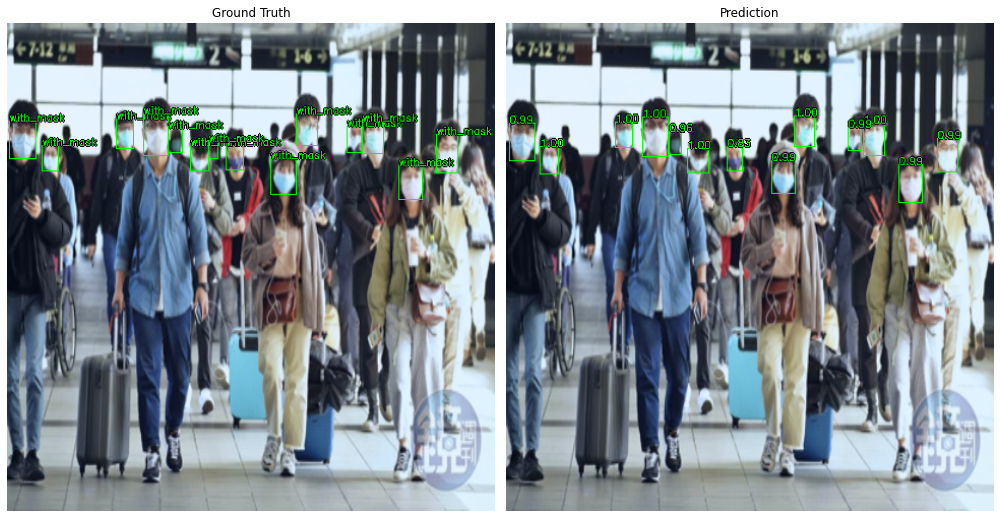

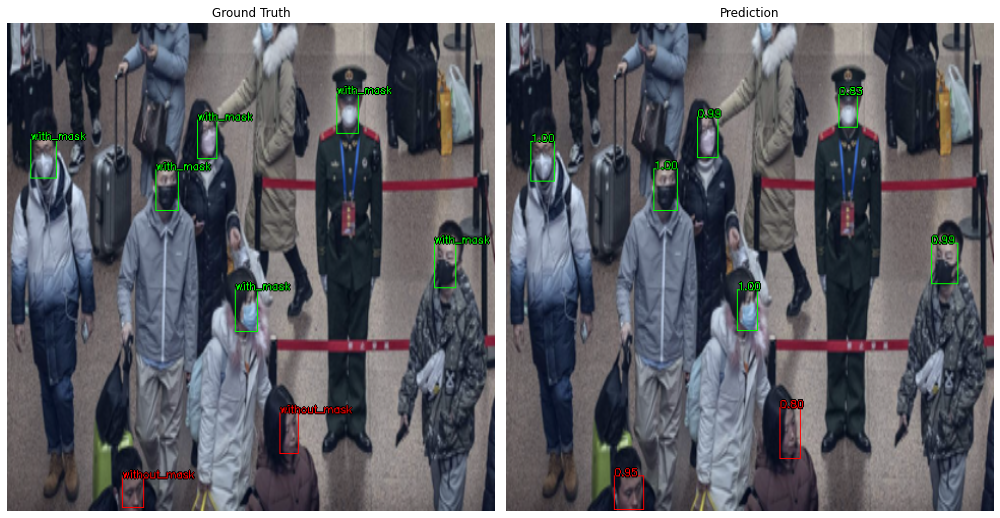

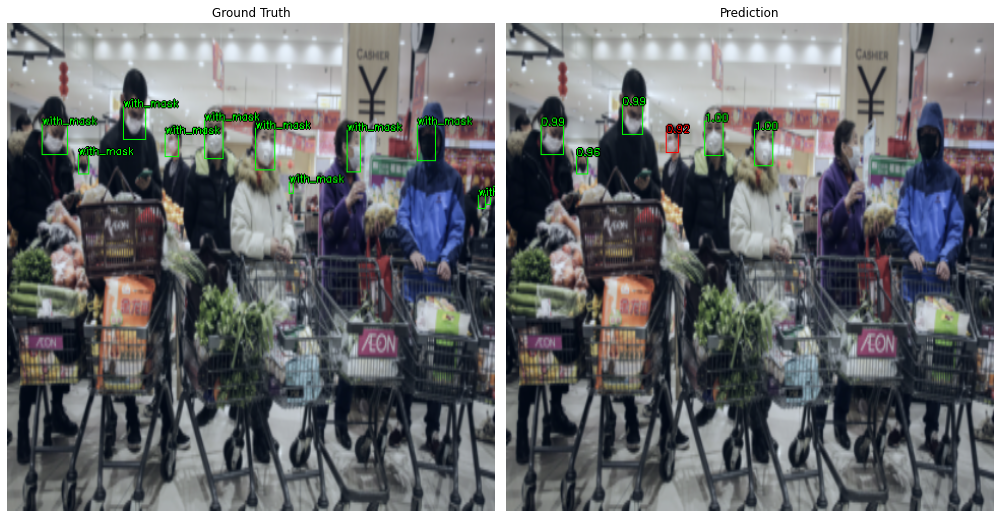

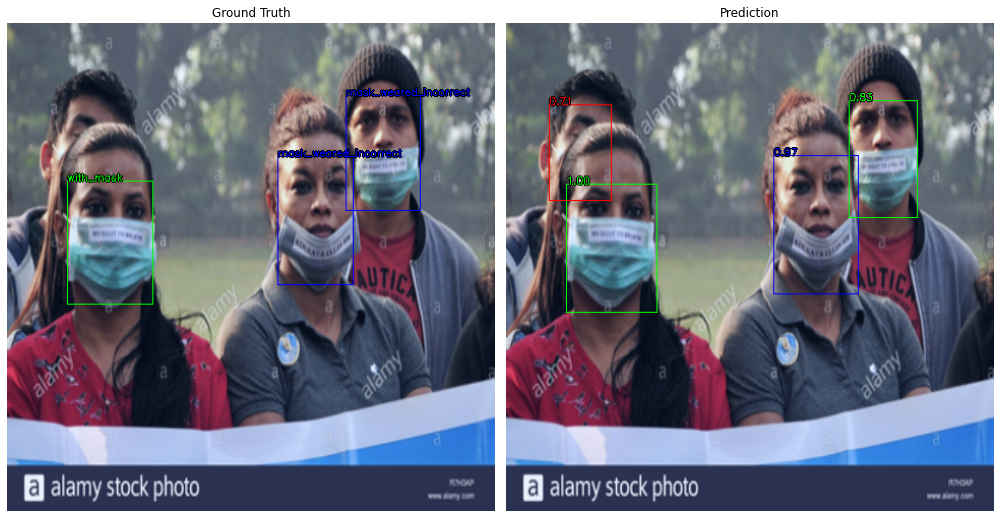

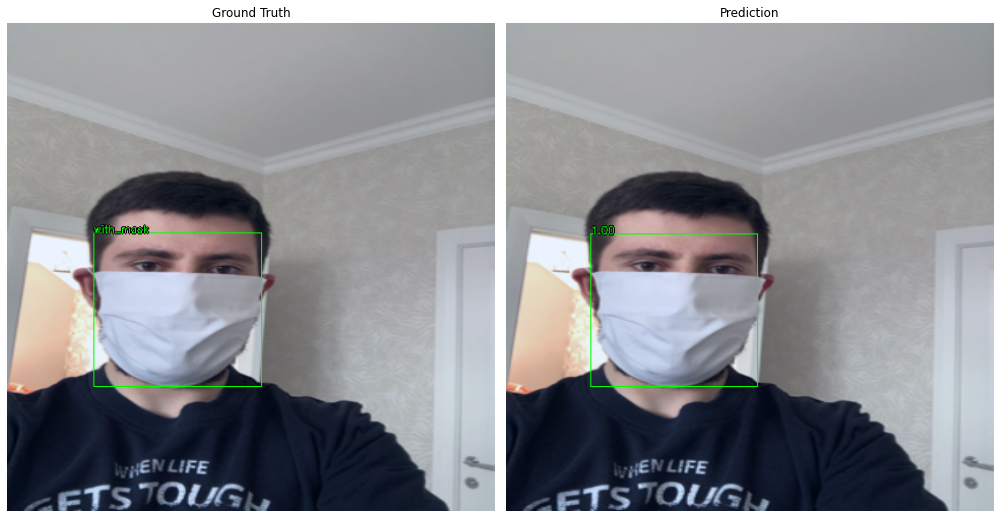

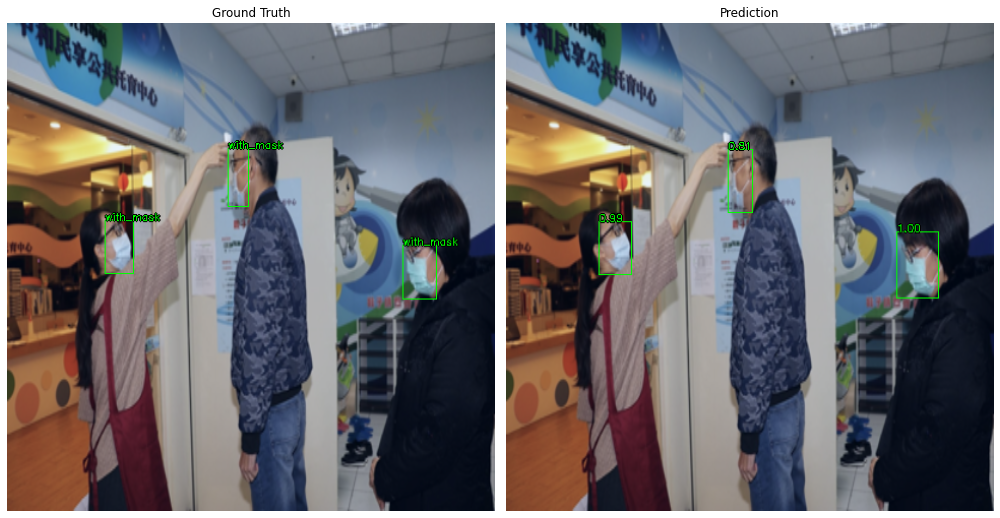

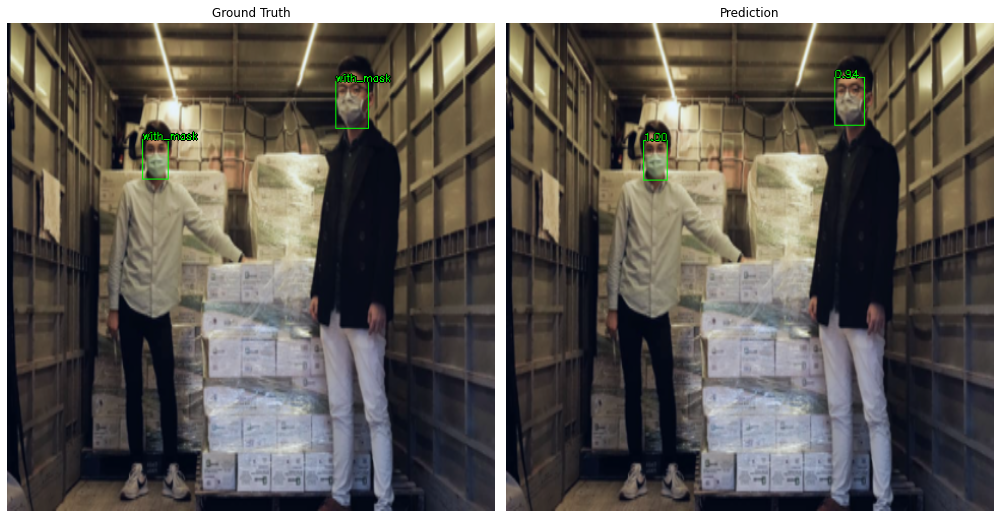

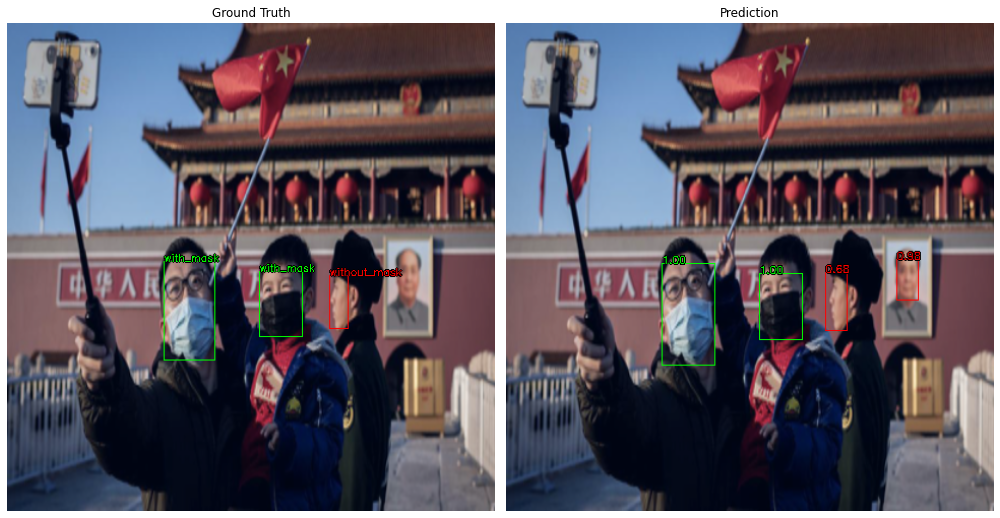

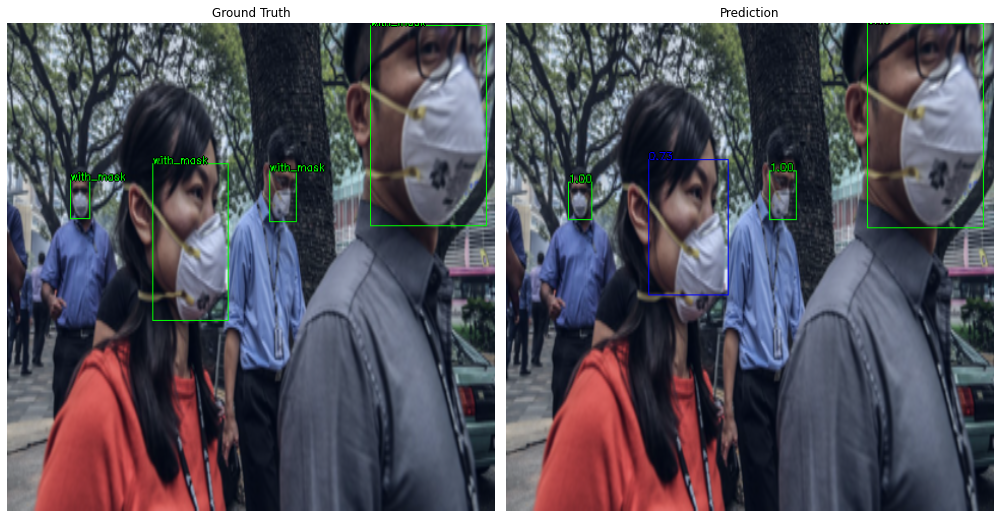

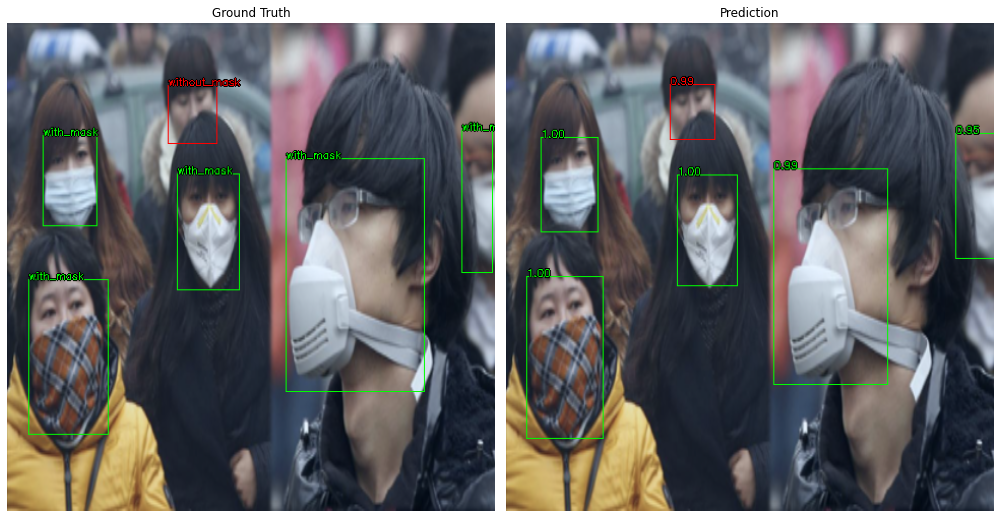

In [31]:
def plot_test_examples(model, loader, nms_threshold, score_threshold):
    device = CFG.device
    model = model.to(device).eval()

    imgs, annts = next(iter(loader))
    imgs  = list(img.to(device) for img in imgs)

    output = model(imgs)

    amount_samples = min(12, len(imgs))          #   number of examples will be at most 12

    for i, (img, ant, pred) in enumerate(zip(imgs, annts, output)):
        if i >= amount_samples:
            break
            
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 60))

        axes[0].set_title('Ground Truth')
        axes[1].set_title('Prediction')

        axes[0].axis('off')
        axes[1].axis('off')

        annot_img = get_annotated_img(img.cpu().detach().numpy(), ant)
        axes[0].imshow(norm(annot_img))          

        pred_thrs = get_pred_by_threshold(pred, nms_threshold, score_threshold)
        pred_cpu = {k: v.cpu().detach().numpy() for k, v in pred_thrs.items()}
        
        annot_img = get_annotated_img(img.cpu().detach().numpy(), pred_cpu, is_pred=True)
        axes[1].imshow(norm(annot_img))  

        fig.tight_layout()
        plt.show()

    del imgs, pred, pred_thrs, pred_cpu
    torch.cuda.empty_cache()

plot_test_examples(model, test_loader, nms_threshold=CFG.nms_thresh, score_threshold=CFG.score_threshold)

### Mean Average Precision
mAP@[0.5:0.05:0.95]


In [32]:
def plot_precision_recall(df, iou_thresh, save_path=None):
    
    auc_dict = dict()
    
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(25, 7))
    plt.title('IoU Threshold {:.3f}'.format(iou_thresh))
    
    for idx, c in enumerate(df['real_class'].unique()):
        
        prec = df[df['real_class']==c]['precision']
        recall = df[df['real_class']==c]['recall']

        prec = pd.concat([ pd.Series([prec.iloc[0]]), prec ])
        recall = pd.concat([ pd.Series([0]), recall ])

        prec = pd.concat([ prec, pd.Series([0]) ])
        recall = pd.concat([ recall, pd.Series([ recall.iloc[len(recall)-1] ]) ])
        
        auc = metrics.auc(x=recall, y=prec)
        auc_dict[c] = auc
        axes[idx].plot(recall, prec)
        axes[idx].set_title('Class {} AP@{:.2f}={:.5f}'.format(faceMasksData.classes[c], iou_thresh, auc))
        axes[idx].grid()
        axes[idx].set_ylabel('Precision')
        axes[idx].set_xlabel('Recall')
        axes[idx].axis([-0.01, 1.01, -0.01, 1.01])
        
    fig.tight_layout()
    plt.show()

    if save_path:
        fig.savefig('{}/AP@{:.3}.png'.format(save_path, iou_thresh))
    
    return auc_dict

In [33]:
def plot_mAP_graph(iou_dict, save_path=None, iou_start=0.5, iou_step=0.05, iou_end=0.95):
    x, y = zip(*sorted(iou_dict.items()))

    fig = plt.figure(figsize=(25, 7))
    plt.title('mAP Vs. IoU Threshold')
    plt.plot(x, y, marker='o')
    plt.tight_layout()
    plt.grid()
    plt.show()

    save_path = '{}/mAP@[{:.3}:{:.3}:{:.3}].png'.format(save_path, iou_start, iou_step, iou_end)
    fig.savefig(save_path)

evaluating IoU: 100%|██████████| 9/9 [00:08<00:00,  1.11it/s]


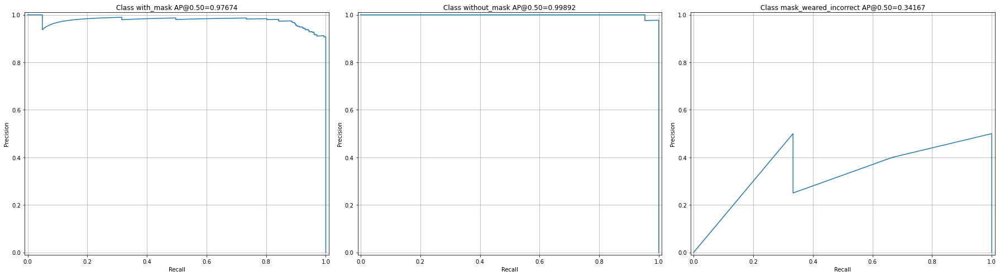

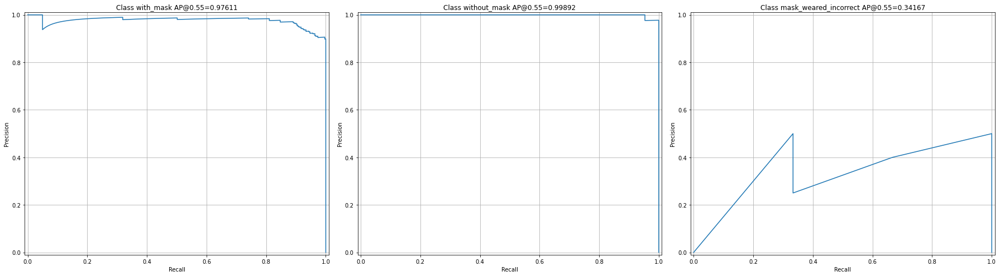

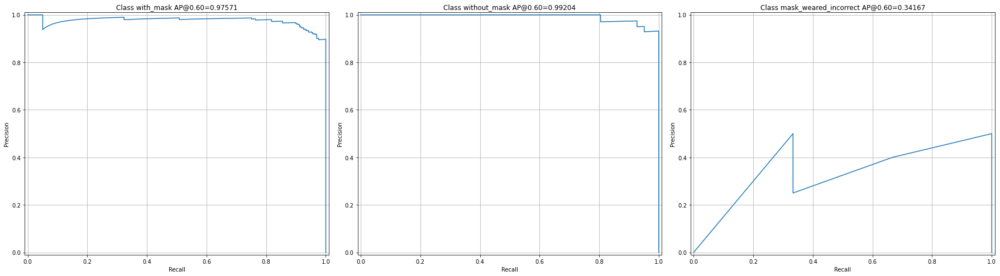

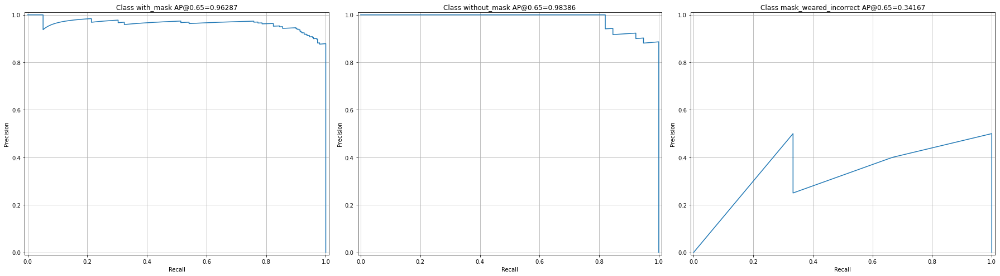

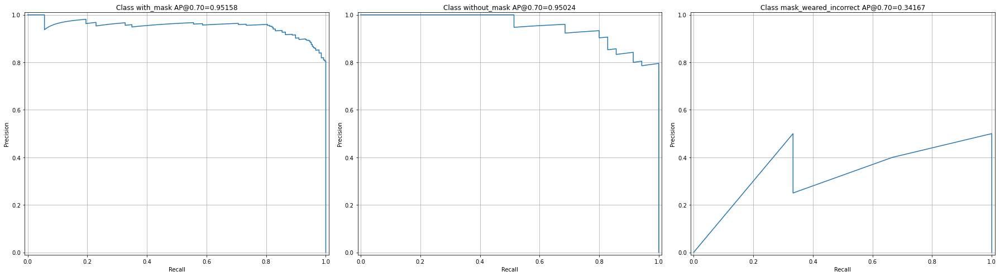

...

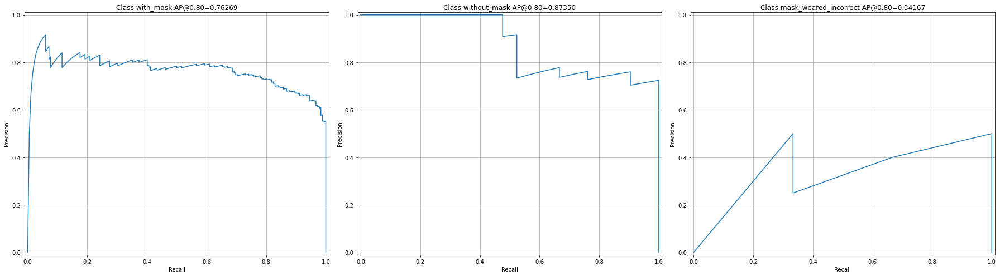

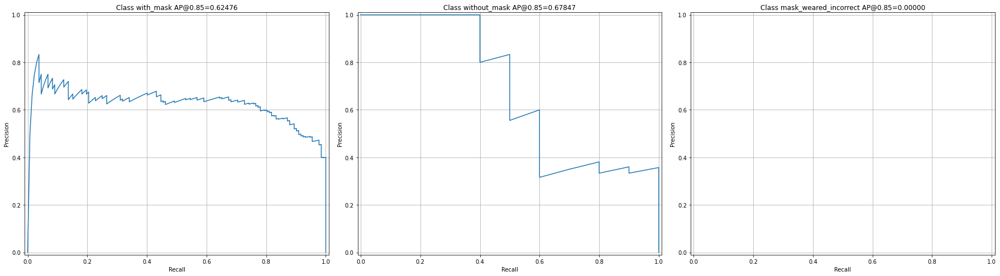

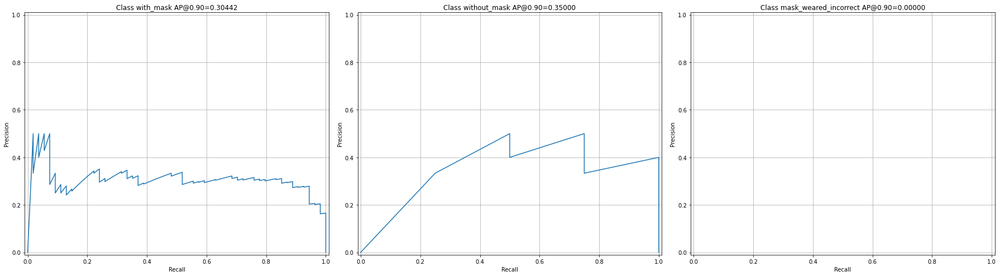

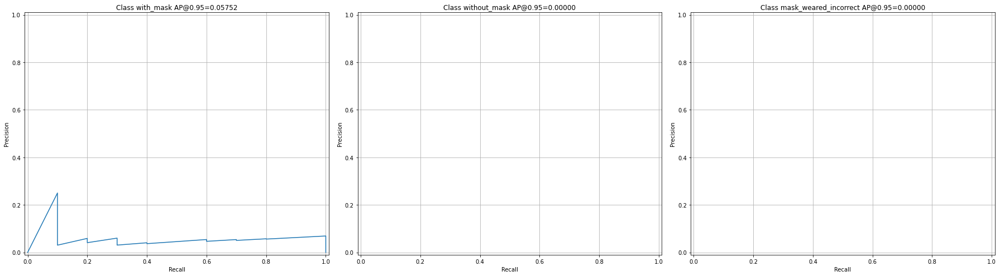

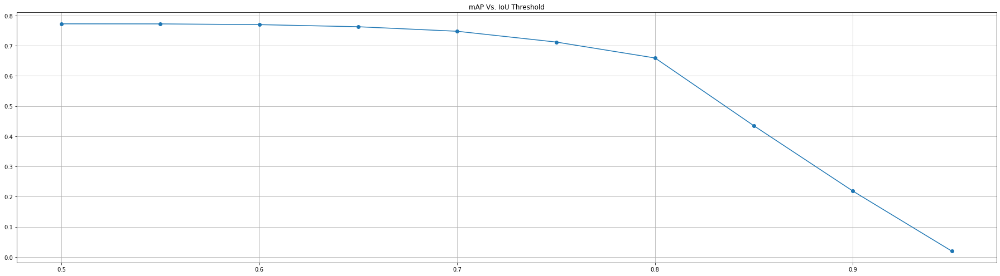

mAP@0.5 =	0.77244
mAP@0.55 =	0.77223
mAP@0.6 =	0.76981
mAP@0.65 =	0.7628
mAP@0.7 =	0.74783
mAP@0.75 =	0.71212
mAP@0.8 =	0.65929
mAP@0.85 =	0.43441
mAP@0.9 =	0.21814
mAP@0.95 =	0.019173

mAP Per Class:
with_mask		mAP@[0.5:0.05:0.95] =	0.75002
without_mask		mAP@[0.5:0.05:0.95] =	0.77128
mask_weared_incorrect		mAP@[0.5:0.05:0.95] =	0.23917
Total mAP@[0.5:0.05:0.95] =	0.58682


In [34]:
def evaluate(model, loader, nms_thresh, score_threshold=0, iou_start=0.5, iou_step=0.05, iou_end=0.95, eps=1e-6):
       
    metrics_path = '{}/metrics'.format(run_path)
    df = get_iou_as_df(model, loader, nms_thresh, score_threshold)
    auc_dict = dict()
    
    for iou_trsh in np.arange(iou_start, iou_end + iou_step, iou_step):
        
        df = calc_precision_recall(df, iou_trsh, metrics_path)
        # display(df)
        auc_dict[iou_trsh] = plot_precision_recall(df, iou_trsh, metrics_path)
    
    iou_dict = calc_mAP_from_auc_dict(auc_dict)
    classes_mAP = calc_mAP_per_class(auc_dict, iou_dict)

    plot_mAP_graph(iou_dict, metrics_path, iou_start, iou_step, iou_end)
    
    total_mAP = .0
    print()
    for iou in iou_dict:
        print('mAP@{:.3} =\t{:.5}'.format(iou, iou_dict[iou]))
    print('\nmAP Per Class:')
    for c, val in classes_mAP.items():
        total_mAP += val
        print('{}\t\tmAP@[0.5:0.05:0.95] =\t{:.5f}'.format(faceMasksData.classes[c], classes_mAP[c]))
    total_mAP /= len(classes_mAP)
    print('Total mAP@[0.5:0.05:0.95] =\t{:.5f}'.format(total_mAP))

evaluate(model, test_loader, CFG.nms_thresh, CFG.score_threshold)

## References
* [Face Mask Get Annotation Info from XML into DataFrame](https://www.kaggle.com/stpeteishii/face-mask-get-annotation-info-from-xml)
* [TORCHVISION OBJECT DETECTION FINETUNING TUTORIAL](https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html)
* [a-PyTorch-Tutorial-to-Object-Detection](https://github.com/sgrvinod/a-PyTorch-Tutorial-to-Object-Detection)
* [mAP (mean Average Precision) for Object Detection](https://jonathan-hui.medium.com/map-mean-average-precision-for-object-detection-45c121a31173)
* [Face Mask Detection Dataset](https://www.kaggle.com/andrewmvd/face-mask-detection)
* [MultiLabelStratifiedKFold](https://github.com/trent-b/iterative-stratification)

* [Kaggle Notebook](https://www.kaggle.com/daniel601/pytorch-fasterrcnn)
* [Kaggle Notebook](https://www.kaggle.com/jiaxxx/vmi-homework)